## 모듈

In [2]:
import numpy as np
import xarray as xr
import pandas as pd
from netCDF4 import Dataset, MFDataset
import netCDF4
import matplotlib.pyplot as plt
import glob
from datetime import datetime, timedelta
from scipy import stats
import shutil
from scipy.spatial import distance
import metpy
import xskillscore as xs
import matplotlib.ticker as mticker
import cartopy.feature as cfeature
import cartopy.crs as ccrs
import cartopy.mpl.ticker as cticker
from cartopy.util import add_cyclic_point
from cartopy.feature import NaturalEarthFeature
from glob import *
import sys, os, time, warnings
import pandas as pd
import pytz
from cartopy.mpl.gridliner import LongitudeFormatter, LatitudeFormatter
warnings.filterwarnings(action='ignore')
warnings.simplefilter(action='ignore')
from dask.diagnostics import ProgressBar

## function  
아래의 함수들 포함.  

fft_1st_phase(a)  
find_nearest(array, value)  
find_nearest_idx(array, value) 
harm_1st_max_idx(array, values)  
diurnal_cycle_fig(data,daily_mean_data,time,data_source)  
grid_transfer(data)  
regrid(change_data,target_data)  
amplitude_fig(data,data_source)amplitude_fig(data,data_source)  
print(f"latitude : {i}", end='\r') # 순서 보여주는거


### harmonic analysis function

In [3]:
def fft_1st_phase(a):
    ff = np.fft.fft(a)
    # Get the complex vector at that frequency to retrieve amplitude and phase shift
    yy = ff[1] 

    # Calculate the amplitude
    T = a.shape[0] # domain of x; which we will divide height to get freq amplitude
    A = np.sqrt(yy.real**2 + yy.imag**2)/T 
    # print('amplitude of:', A) 
    
    # Calculate phase shift
    phi = np.arctan(yy.imag/yy.real)
    # print('phase change:', phi)
    
    return phi, yy.real ,A


def find_nearest(array, value):
    array = np.asarray(array)
    idx = (np.abs(array - value)).argmin()
    return array[idx]

def find_nearest_idx(array, value):
    array = np.asarray(array)
    idx = (np.abs(array - value)).argmin()
    return idx

def harm_1st_max_idx(array, values): # 앞에가 시간 뒤에가 강수
    pp=0
    if fft_1st_phase(values)[1]>0:
        if fft_1st_phase(values)[0]<0:
            pp = -fft_1st_phase(values)[0]/np.pi *np.pi
        elif fft_1st_phase(values)[0]>0:
            pp = ( 2. - fft_1st_phase(values)[0]/np.pi ) *np.pi
    elif fft_1st_phase(values)[1]<0:
        pp = ( -fft_1st_phase(values)[0]/np.pi + 1. ) *np.pi    
    
    pp2 = np.nanmax(array,axis=0) * pp / (2.*np.pi)    
    return find_nearest_idx(array, pp2)

### diurnal cycle fig function

In [4]:
def diurnal_cycle_fig(data,daily_mean_data,time,data_source):

    if time == 'utc':
        tt = 'UTC(hour)'
    else : 
        tt = 'LST(hour)'
        
    tick_spacing = 30

    projection = ccrs.PlateCarree()
    crs = ccrs.PlateCarree()
    fig = plt.figure(figsize=(20,10))
    ax = plt.axes(projection=projection, frameon=True)


    varMin, varMax, varInt = 0, 24, 1
    levels = np.arange(varMin, varMax+varInt, varInt)
    nlevs  = levels.size
    tick_interval = 2
    cmap = plt.get_cmap('Spectral', nlevs)
    extent=[-180, 180, -60, 60]
    gl = ax.gridlines(crs=crs, draw_labels=True, linewidth=1, color='gray', alpha=1, linestyle='-.')
    gl.xlabel_style = {"size" : 13}
    gl.ylabel_style = {"size" : 13}
    gl.xlocator = mticker.FixedLocator(np.arange(extent[0], extent[1] + tick_spacing, tick_spacing))
    gl.ylocator = mticker.FixedLocator(np.arange(extent[2], extent[3] + tick_spacing, tick_spacing))

    ax.xaxis.set_major_formatter(LongitudeFormatter())
    ax.yaxis.set_major_formatter(LatitudeFormatter()) 

    gl.top_labels = None
    gl.right_labels = None

    ax.add_feature(cfeature.COASTLINE.with_scale("50m"), lw=0.8)
    ax.add_feature(cfeature.OCEAN.with_scale("50m"), edgecolor='none', facecolor='lightgray')
    ax.add_feature(cfeature.BORDERS.with_scale("50m"), lw=0.3)
    ax.set_extent([-180, 180, -60, 60], crs=ccrs.PlateCarree())

    lons = data['longitude']  # 경도
    lats = data['latitude']  # 위도
    values = data[time]

    lons, lats = np.meshgrid(data['longitude'], data['latitude'])

    cnplot = ax.contourf(lons, lats, values,cmap=cmap,levels=levels,zorder=0,transform=ccrs.PlateCarree())

    cbar = plt.colorbar(cnplot,ticks=np.arange(varMin, varMax+tick_interval, tick_interval), 
                        orientation='vertical', pad=0.01, shrink=.575) 

    zm = np.ma.masked_less(daily_mean_data, 0.275)
    plt.pcolor(lons, lats,zm, hatch='xxx', alpha=0.)

    cbar.set_label(tt, fontsize=15)
    cbar.ax.tick_params(labelsize=15)

    plt.xlabel('Longitude',fontsize=10,fontweight='bold')
    plt.ylabel('Latitude',fontsize=10,fontweight='bold')    
    ax.set_title(data_source+' [JJA 2022]',fontsize=20,fontweight='bold')
    plt.show()


### grid inverse function

In [5]:
def grid_transfer(data):
    data=data.sortby(data['latitude'], ascending=True) #위도 ㅂ반전
    data['longitude'] = xr.where(data['longitude'] > 180, data['longitude'] - 360, data['longitude']) # 경도 반전
    data = data.sortby(data['longitude']) #바뀐 경도에 대해 값들 맞춰줌 한번만 실행할것
    
    return data

### amplitude_fig

In [6]:
def amplitude_fig(data,data_source):

    tick_spacing = 30
    projection = ccrs.PlateCarree()
    crs = ccrs.PlateCarree()
    fig = plt.figure(figsize=(20,10))
    ax = plt.axes(projection=projection, frameon=True)


    varMin, varMax, varInt = 0, 2, 0.1
    levels = np.arange(varMin, varMax+varInt, varInt)
    nlevs  = levels.size
    tick_interval = 0.2
    cmap = plt.get_cmap('plasma', nlevs)
    extent=[-180, 180, -60, 60]

    gl = ax.gridlines(crs=crs, draw_labels=True, linewidth=1, color='gray', alpha=1, linestyle='-.')
    gl.xlabel_style = {"size" : 13}
    gl.ylabel_style = {"size" : 13}
    gl.xlocator = mticker.FixedLocator(np.arange(extent[0], extent[1] + tick_spacing, tick_spacing))
    gl.ylocator = mticker.FixedLocator(np.arange(extent[2], extent[3] + tick_spacing, tick_spacing))

    ax.xaxis.set_major_formatter(LongitudeFormatter())
    ax.yaxis.set_major_formatter(LatitudeFormatter()) 

    gl.top_labels = None
    gl.right_labels = None

    ax.add_feature(cfeature.COASTLINE.with_scale("50m"), lw=0.8)
    ax.add_feature(cfeature.OCEAN.with_scale("50m"), edgecolor='none', facecolor='lightgray')
    ax.add_feature(cfeature.BORDERS.with_scale("50m"), lw=0.3)
    ax.set_extent([-180, 180, -60, 60], crs=ccrs.PlateCarree())

    lons = data['longitude']  # 경도
    lats = data['latitude']  # 위도
    values = data['amlitude']

    lons, lats = np.meshgrid(data['longitude'], data['latitude'])

    cnplot = ax.contourf(lons, lats, values,cmap=cmap,levels=levels,zorder=0,
                         transform=ccrs.PlateCarree(),extend='max')

    cbar = plt.colorbar(cnplot,ticks=np.arange(varMin, varMax+tick_interval, tick_interval), 
                        orientation='vertical', pad=0.01, shrink=.56) 

    # zm = np.ma.masked_less(daily_mean_data, 0.275)
    # plt.pcolor(lons, lats,zm, hatch='xxx', alpha=0.)

    cbar.set_label('Amplitude', fontsize=15)
    cbar.ax.tick_params(labelsize=15)

    plt.xlabel('Longitude',fontsize=10,fontweight='bold')
    plt.ylabel('Latitude',fontsize=10,fontweight='bold')    
    ax.set_title(data_source+' [JJA 2022]',fontsize=20,fontweight='bold')
    plt.show()


### grid same

In [7]:
import xesmf as xe

In [8]:
def regrid(change_data,target_data):
    grid_frame = xe.Regridder(change_data, target_data, "bilinear")
    regrid_data=grid_frame(change_data)
    return regrid_data

## 자료처리

###### MSWEP 확인해보기

In [8]:
mswep_mean = xr.open_dataset('/home/gychoi/Python/Lab/output_file/professor_file/mswep_mean.nc')

In [9]:
mswep= xr.open_dataset('/home/gychoi/Python/Lab/output_file/professor_file/mswep_diurnal_data.nc')

In [10]:
mswep

<xarray.Dataset>
Dimensions:    (latitude: 1440, longitude: 2880)
Coordinates:
  * latitude   (latitude) float64 -89.94 -89.81 -89.69 ... 89.69 89.81 89.94
  * longitude  (longitude) float64 -179.9 -179.8 -179.6 ... 179.8 179.9 180.0
Data variables:
    utc        (latitude, longitude) float64 ...
    lst        (latitude, longitude) float64 ...
    amplitude  (latitude, longitude) float64 ...

In [17]:
mswep_mean

<xarray.Dataset>
Dimensions:        (latitude: 1440, longitude: 2880)
Coordinates:
  * latitude       (latitude) float64 -89.94 -89.81 -89.69 ... 89.69 89.81 89.94
  * longitude      (longitude) float64 -179.9 -179.8 -179.6 ... 179.9 180.0
Data variables:
    precipitation  (latitude, longitude) float32 0.1631 0.1629 ... 0.9991 0.0
Attributes:
    regrid_method:  bilinear

In [12]:
mswep_mean=regrid(mswep_mean,mswep)

In [13]:
amp30 = mswep['amplitude'].quantile(0.3, dim=['latitude','longitude']) 

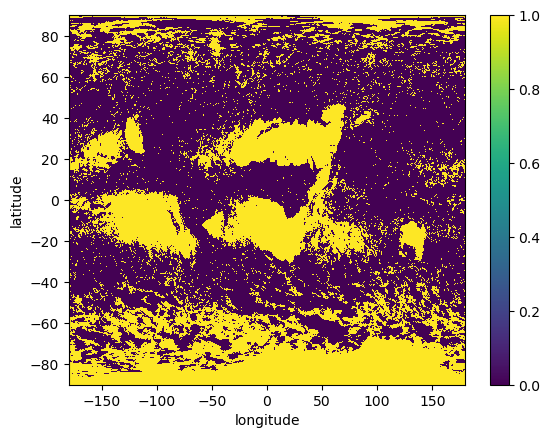

In [18]:
((mswep['amplitude']<amp30.values) | (mswep_mean['precipitation']<=0.275)).plot()

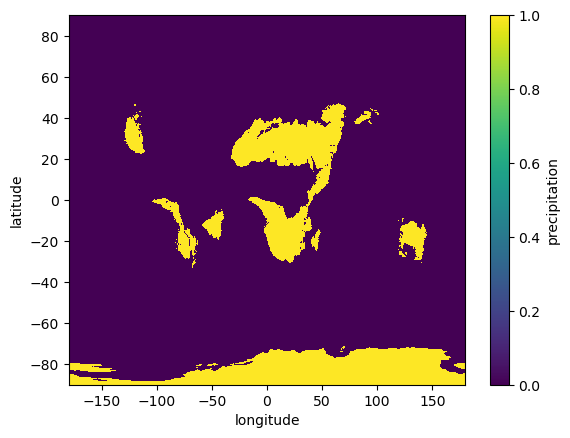

In [21]:
(mswep_mean['precipitation']<=0.275).plot()

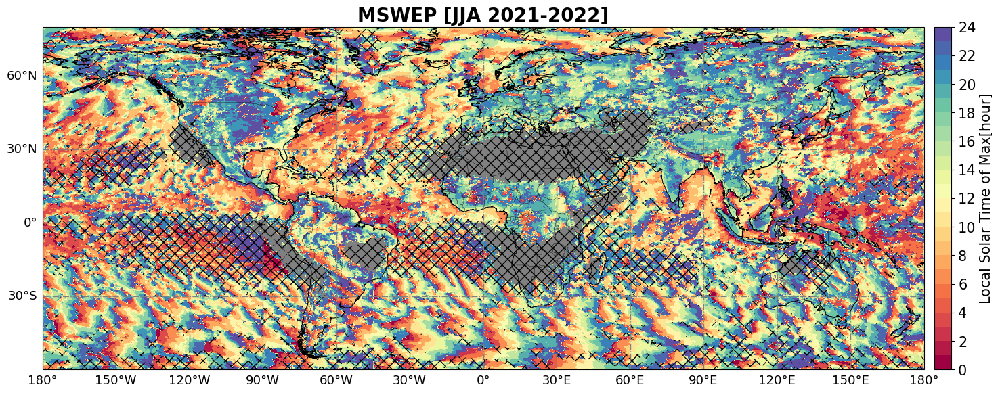

In [22]:
with ProgressBar():# 이거 좋네?
    #utc
    nan_mask = np.isnan(mswep['amplitude']) 
    hatch_mask = ((mswep['amplitude']<amp30.values) | (mswep_mean['precipitation']<=0.275))
    tick_spacing = 30

    projection = ccrs.PlateCarree()
    crs = ccrs.PlateCarree()
    fig = plt.figure(figsize=(20,10))
    ax = plt.axes(projection=projection, frameon=True)


    varMin, varMax, varInt = 0, 24, 1
    levels = np.arange(varMin, varMax+varInt, varInt)
    nlevs  = levels.size
    tick_interval = 2
    cmap = plt.get_cmap('Spectral', nlevs)
    extent=[-180, 180, -60, 80]
    gl = ax.gridlines(crs=crs, draw_labels=True, linewidth=1, color='gray', alpha=1, linestyle='-.')
    gl.xlabel_style = {"size" : 13}
    gl.ylabel_style = {"size" : 13}
    gl.xlocator = mticker.FixedLocator(np.arange(extent[0], extent[1] + tick_spacing, tick_spacing))
    gl.ylocator = mticker.FixedLocator(np.arange(extent[2], extent[3] + tick_spacing, tick_spacing))

    ax.xaxis.set_major_formatter(LongitudeFormatter())
    ax.yaxis.set_major_formatter(LatitudeFormatter()) 

    gl.top_labels = None
    gl.right_labels = None

    ax.add_feature(cfeature.COASTLINE.with_scale("50m"), lw=0.8)
    ax.add_feature(cfeature.OCEAN.with_scale("50m"), edgecolor='none', facecolor='lightgray')
    ax.add_feature(cfeature.BORDERS.with_scale("50m"), lw=0.3)
    ax.set_extent([-180, 180, -60, 80], crs=ccrs.PlateCarree())

    lons = mswep['longitude']  # 경도
    lats = mswep['latitude']  # 위도
    values = mswep['lst']

    lons, lats = np.meshgrid(mswep['longitude'], mswep['latitude'])

    cnplot = ax.contourf(lons, lats, values,cmap=cmap,levels=levels,zorder=0,transform=ccrs.PlateCarree())

    cbar = plt.colorbar(cnplot,ticks=np.arange(varMin, varMax+tick_interval, tick_interval), 
                        orientation='vertical', pad=0.01, shrink=.658) 
    
    ax.contourf(
        lons, lats, (nan_mask==True),
        transform=ccrs.PlateCarree(),
        colors='gray',
        levels=[0.5, 1.5],
    ) ## 이거 써야지 제대로 됨
    
    
    ax.contourf(
        lons, lats, hatch_mask,
        transform=ccrs.PlateCarree(),
        colors='none',
        levels=[0.5,1.5],
        hatches=['xx'],
    ) ## 이거 써야지 제대로 됨

    cbar.set_label('Local Solar Time of Max[hour]', fontsize=15)
    cbar.ax.tick_params(labelsize=15)

    plt.xlabel('Longitude',fontsize=10,fontweight='bold')
    plt.ylabel('Latitude',fontsize=10,fontweight='bold')    
    ax.set_title('MSWEP [JJA 2021-2022]',fontsize=20,fontweight='bold')
    plt.show()


##### data load

In [9]:
C=xr.open_dataset('/home/gychoi/Python/Lab/output_file/era_pre_3h.nc')

In [11]:
D=xr.open_dataset('/home/gychoi/Python/Lab/output_file/kim_pre_3h_real.nc')

In [227]:
E=xr.open_dataset('/home/gychoi/Python/Lab/output_file/mswep_pre_3h.nc')

In [83]:
kim= xr.open_dataset('/home/gychoi/Python/Lab/output_file/professor_file/kim_diurnal_data.nc')

In [ ]:
kim=xr.open_dataset('/home/gychoi/Python/Lab/output_file/중요/class_data/KIM_complete.nc')
#amplitude, norm_amplitude,mean 전부 들어있음 2021~2022

In [ ]:
mswep=xr.open_dataset('/home/gychoi/Python/Lab/output_file/중요/class_data/MSWEP2021_complete.nc')
#amplitude, norm_amplitude,mean 전부 들어있음 2021~2022

In [ ]:
mswep_2000 = xr.open_dataset('/home/gychoi/Python/Lab/output_file/중요/class_data/MSWEP_complete.nc')
#amplitude, norm_amplitude,mean 전부 들어있음 2000~2019

In [69]:
mswep= xr.open_dataset('/home/gychoi/Python/Lab/output_file/professor_file/mswep_diurnal_data.nc')

In [9]:
mswep2000 = xr.open_dataset('/home/gychoi/Python/Lab/output_file/중요/class_data/MSWEP_diurnal.nc')
#제 1주파 찾기 위한 base 파일임 2000~2019

In [11]:
D=xr.open_dataset('/home/gychoi/Python/Lab/output_file/kim_pre_3h_real.nc')

In [13]:
mswep2000 = regrid(mswep2000,D)

In [14]:
mswep2000

<xarray.Dataset>
Dimensions:        (hour: 8, latitude: 1440, longitude: 2880)
Coordinates:
  * hour           (hour) int64 0 3 6 9 12 15 18 21
  * longitude      (longitude) float64 0.0 0.125 0.25 ... 359.6 359.8 359.9
  * latitude       (latitude) float64 89.94 89.81 89.69 ... -89.69 -89.81 -89.94
Data variables:
    precipitation  (hour, latitude, longitude) float32 0.3755 0.3758 ... 0.1524
Attributes:
    regrid_method:  bilinear

In [61]:
era_mean=xr.open_dataarray('/home/gychoi/Python/Lab/output_file/era_jja_mean.nc')

In [82]:
kim_mean=xr.open_dataarray('/home/gychoi/Python/Lab/output_file/kim_jja_mean_real.nc')

In [70]:
mswep_mean=xr.open_dataarray('/home/gychoi/Python/Lab/output_file/mswep_jja_mean_real.nc')

In [228]:
E = regrid(E,D)

In [229]:
E

<xarray.Dataset>
Dimensions:        (hour: 8, latitude: 1440, longitude: 2880)
Coordinates:
  * hour           (hour) int64 0 3 6 9 12 15 18 21
  * longitude      (longitude) float64 0.0 0.125 0.25 ... 359.6 359.8 359.9
  * latitude       (latitude) float64 89.94 89.81 89.69 ... -89.69 -89.81 -89.94
Data variables:
    precipitation  (hour, latitude, longitude) float64 0.4018 0.4017 ... 0.1717
Attributes:
    regrid_method:  bilinear

In [253]:
mswep_mean = regrid(mswep_mean,D.mean('hour'))

In [54]:
mswep_mean = grid_transfer(mswep_mean)

In [52]:
kim_mean = grid_transfer(kim_mean)

### mswep 2000~2019

In [9]:
mswep2000 = xr.open_dataset('/home/gychoi/Python/Lab/output_file/중요/class_data/MSWEP_diurnal.nc')

In [13]:
mswep2000 = regrid(mswep2000,D)

In [14]:
mswep2000

<xarray.Dataset>
Dimensions:        (hour: 8, latitude: 1440, longitude: 2880)
Coordinates:
  * hour           (hour) int64 0 3 6 9 12 15 18 21
  * longitude      (longitude) float64 0.0 0.125 0.25 ... 359.6 359.8 359.9
  * latitude       (latitude) float64 89.94 89.81 89.69 ... -89.69 -89.81 -89.94
Data variables:
    precipitation  (hour, latitude, longitude) float32 0.3755 0.3758 ... 0.1524
Attributes:
    regrid_method:  bilinear

#### MSWEP

In [15]:
import xarray as xr # 데이터가 들어갈 데이터셋을 미리 만들어줌
import numpy as np

longitude = mswep2000['longitude'].values
latitude = mswep2000['latitude'].values

mswep = xr.Dataset(
    {
        'latitude': (['latitude'], latitude),'longitude': (['longitude'], longitude)
    }
)
mswep['utc'] = xr.DataArray(np.full((len(mswep['latitude']), len(mswep['longitude'])), np.nan), dims=['latitude', 'longitude'])
mswep['lst'] = xr.DataArray(np.full((len(mswep['latitude']), len(mswep['longitude'])), np.nan), dims=['latitude', 'longitude'])
mswep['amplitude'] = xr.DataArray(np.full((len(mswep['latitude']), len(mswep['longitude'])), np.nan), dims=['latitude', 'longitude'])

In [16]:
mswep

<xarray.Dataset>
Dimensions:    (latitude: 1440, longitude: 2880)
Coordinates:
  * latitude   (latitude) float64 89.94 89.81 89.69 ... -89.69 -89.81 -89.94
  * longitude  (longitude) float64 0.0 0.125 0.25 0.375 ... 359.6 359.8 359.9
Data variables:
    utc        (latitude, longitude) float64 nan nan nan nan ... nan nan nan nan
    lst        (latitude, longitude) float64 nan nan nan nan ... nan nan nan nan
    amplitude  (latitude, longitude) float64 nan nan nan nan ... nan nan nan nan

In [17]:
mswep2000

<xarray.Dataset>
Dimensions:        (hour: 8, latitude: 1440, longitude: 2880)
Coordinates:
  * hour           (hour) int64 0 3 6 9 12 15 18 21
  * longitude      (longitude) float64 0.0 0.125 0.25 ... 359.6 359.8 359.9
  * latitude       (latitude) float64 89.94 89.81 89.69 ... -89.69 -89.81 -89.94
Data variables:
    precipitation  (hour, latitude, longitude) float32 0.3755 0.3758 ... 0.1524
Attributes:
    regrid_method:  bilinear

##### UTC,Amplitude

In [18]:
with ProgressBar():
    for i in range (len(mswep2000['latitude'])):
        for j in range (len(mswep2000['longitude'])):
            mswep['utc'][i][j]=mswep2000['hour'].values[int(harm_1st_max_idx(mswep2000['hour'],mswep2000['precipitation'].isel(longitude=j,latitude=i).values))]
            mswep['amplitude'][i][j]= fft_1st_phase(mswep2000['precipitation'].isel(latitude=i,longitude=j).values)[2]

        print(f"latitude : {i}", end='\r')

##### LST

In [19]:
for i in range(len(mswep['longitude'])):
    for j in range (len(mswep['latitude'])):
        if (mswep['utc'][j][i].values + float(mswep['longitude'][i].values / 15))>24. :
            mswep['lst'][j][i]= (mswep['utc'][j][i].values + float( mswep['longitude'][i].values / 15)) - 24
            
        else:
            mswep['lst'][j][i]= mswep['utc'][j][i].values + float( mswep['longitude'][i].values / 15)
            
    print(f"longitude : {i}", end='\r')

In [23]:
mswep = grid_transfer(mswep)

In [21]:
mswep_mean = xr.open_dataset('/home/gychoi/Python/Lab/output_file/professor_file/mswep_mean.nc')

In [24]:
mswep_mean = regrid(mswep_mean,mswep)

In [30]:
mswep['daily_mean'] = mswep_mean['precipitation']

In [27]:
mswep['norm_amp'] =  mswep['amplitude']/mswep_mean['precipitation']

In [67]:
mswep = xr.open_dataset('/home/gychoi/Python/Lab/output_file/중요/class_data/MSWEP_complete.nc')

In [68]:
mswep

<xarray.Dataset>
Dimensions:     (latitude: 1440, longitude: 2880)
Coordinates:
  * latitude    (latitude) float64 -89.94 -89.81 -89.69 ... 89.69 89.81 89.94
  * longitude   (longitude) float64 -179.9 -179.8 -179.6 ... 179.8 179.9 180.0
Data variables:
    utc         (latitude, longitude) float64 ...
    lst         (latitude, longitude) float64 ...
    amplitude   (latitude, longitude) float64 ...
    norm_amp    (latitude, longitude) float64 ...
    daily_mean  (latitude, longitude) float32 ...

In [39]:
amp20 = mswep['norm_amp'].quantile(0.2, dim=['latitude','longitude']) 

In [52]:
amp30 = mswep['norm_amp'].quantile(0.3, dim=['latitude','longitude']) 

In [53]:
amp40 = mswep['norm_amp'].quantile(0.4, dim=['latitude','longitude']) 

In [59]:
amp50 = mswep['norm_amp'].quantile(0.5, dim=['latitude','longitude']) 

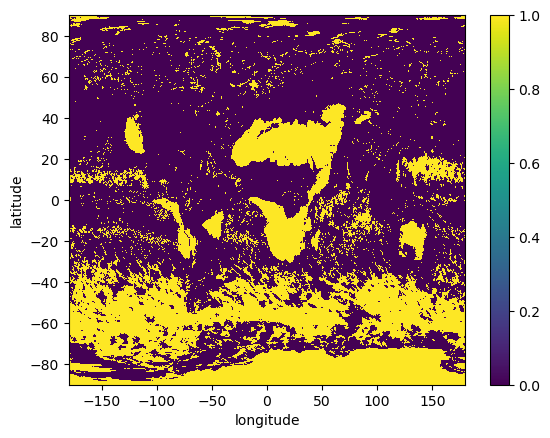

In [40]:
((mswep['norm_amp']<amp20.values) | (mswep['daily_mean']<0.275)).plot()

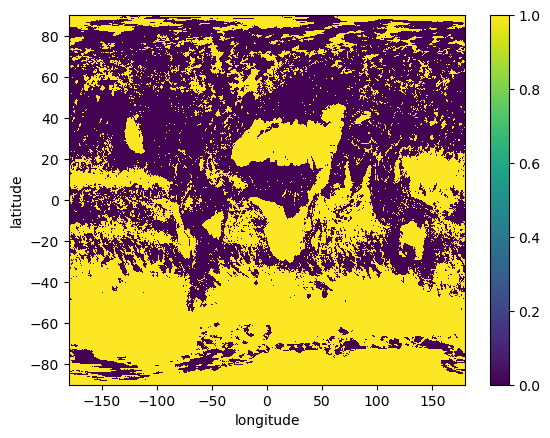

In [54]:
((mswep['norm_amp']<amp40.values) | (mswep['daily_mean']<0.275)).plot()

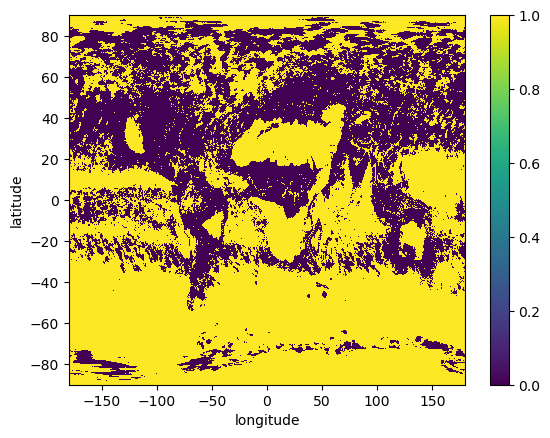

In [60]:
((mswep['norm_amp']<amp50.values) | (mswep['daily_mean']<0.275)).plot()

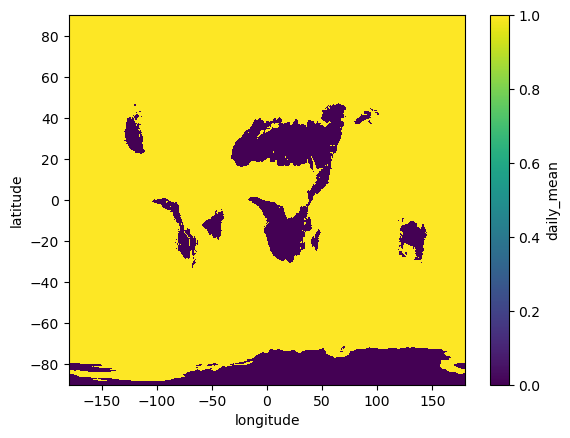

In [44]:
(mswep['daily_mean']>0.275).plot()

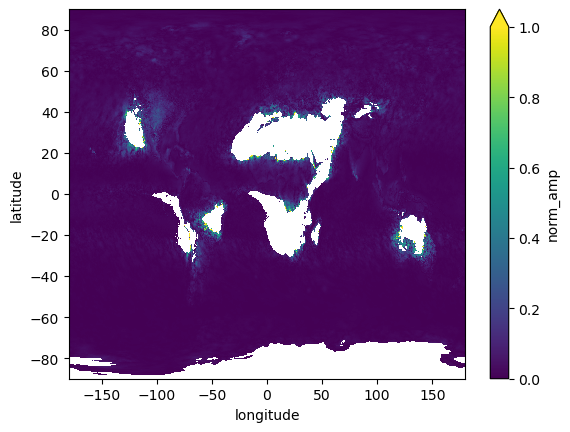

In [43]:
(mswep['norm_amp'].where(mswep['daily_mean']>0.275)).plot(vmin = 0, vmax =1)

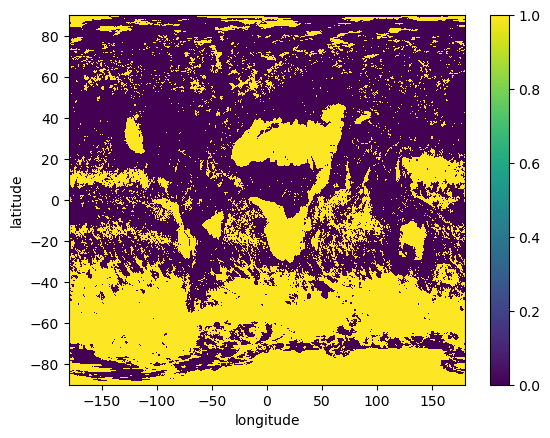

In [48]:
((mswep['norm_amp']<amp30.values) | (mswep['daily_mean']<0.275)).plot()

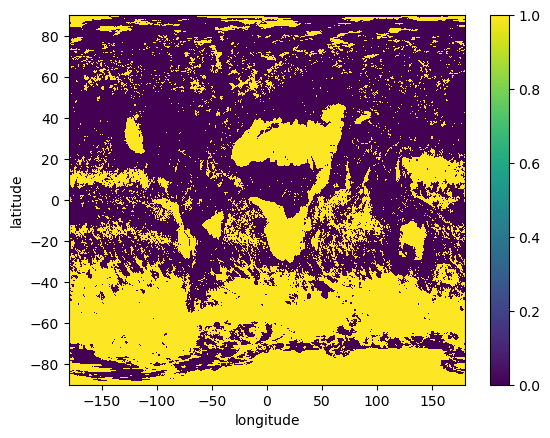

In [45]:
((mswep['norm_amp']<amp30.values) | (mswep['daily_mean']<0.275)).plot()

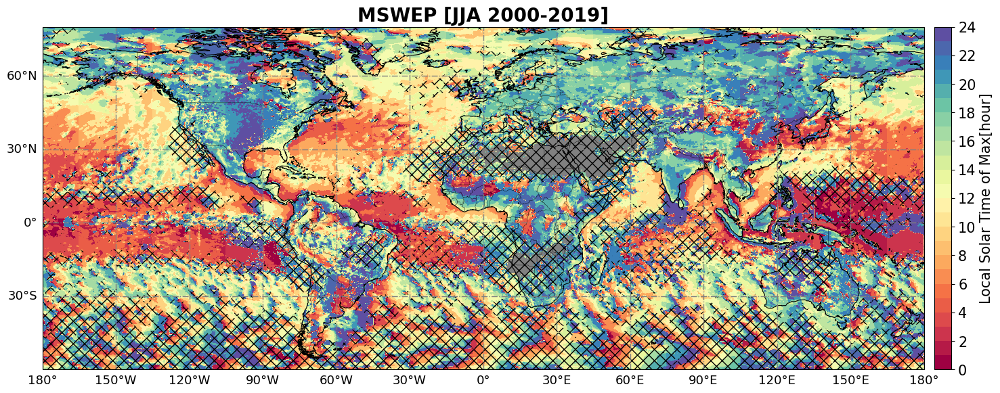

In [58]:
with ProgressBar():# 이거 좋네?
    #utc
    nan_mask = np.isnan(mswep['amplitude']) 
    hatch_mask = ((mswep['norm_amp'].where(mswep['daily_mean']>0.275)<amp30.values) | (mswep['daily_mean']<0.275))
    tick_spacing = 30

    projection = ccrs.PlateCarree()
    crs = ccrs.PlateCarree()
    fig = plt.figure(figsize=(20,10))
    ax = plt.axes(projection=projection, frameon=True)


    varMin, varMax, varInt = 0, 24, 1
    levels = np.arange(varMin, varMax+varInt, varInt)
    nlevs  = levels.size
    tick_interval = 2
    cmap = plt.get_cmap('Spectral', nlevs)
    extent=[-180, 180, -60, 80]
    gl = ax.gridlines(crs=crs, draw_labels=True, linewidth=1, color='gray', alpha=1, linestyle='-.')
    gl.xlabel_style = {"size" : 13}
    gl.ylabel_style = {"size" : 13}
    gl.xlocator = mticker.FixedLocator(np.arange(extent[0], extent[1] + tick_spacing, tick_spacing))
    gl.ylocator = mticker.FixedLocator(np.arange(extent[2], extent[3] + tick_spacing, tick_spacing))

    ax.xaxis.set_major_formatter(LongitudeFormatter())
    ax.yaxis.set_major_formatter(LatitudeFormatter()) 

    gl.top_labels = None
    gl.right_labels = None

    ax.add_feature(cfeature.COASTLINE.with_scale("50m"), lw=0.8)
    ax.add_feature(cfeature.OCEAN.with_scale("50m"), edgecolor='none', facecolor='lightgray')
    ax.add_feature(cfeature.BORDERS.with_scale("50m"), lw=0.3)
    ax.set_extent([-180, 180, -60, 80], crs=ccrs.PlateCarree())

    lons = mswep['longitude']  # 경도
    lats = mswep['latitude']  # 위도
    values = mswep['lst']

    lons, lats = np.meshgrid(mswep['longitude'], mswep['latitude'])

    cnplot = ax.contourf(lons, lats, values,cmap=cmap,levels=levels,zorder=0,transform=ccrs.PlateCarree())

    cbar = plt.colorbar(cnplot,ticks=np.arange(varMin, varMax+tick_interval, tick_interval), 
                        orientation='vertical', pad=0.01, shrink=.658) 
    
    ax.contourf(
        lons, lats, (nan_mask==True),
        transform=ccrs.PlateCarree(),
        colors='gray',
        levels=[0.5, 1.5],
    ) ## 이거 써야지 제대로 됨
    
    
    ax.contourf(
        lons, lats, hatch_mask,
        transform=ccrs.PlateCarree(),
        colors='none',
        levels=[0.5,1.5],
        hatches=['xx'],
    ) ## 이거 써야지 제대로 됨

    cbar.set_label('Local Solar Time of Max[hour]', fontsize=15)
    cbar.ax.tick_params(labelsize=15)

    plt.xlabel('Longitude',fontsize=10,fontweight='bold')
    plt.ylabel('Latitude',fontsize=10,fontweight='bold')    
    ax.set_title('MSWEP [JJA 2000-2019]',fontsize=20,fontweight='bold')
    plt.show()


### diurnal cycle data

#### ERA5

In [213]:
from dask.diagnostics import ProgressBar

In [120]:
import xarray as xr # 데이터가 들어갈 데이터셋을 미리 만들어줌
import numpy as np

longitude = C['longitude'].values
latitude = C['latitude'].values

era = xr.Dataset(
    {
        'latitude': (['latitude'], latitude),'longitude': (['longitude'], longitude)
    }
)
era['utc'] = xr.DataArray(np.full((len(era['latitude']), len(era['longitude'])), np.nan), dims=['latitude', 'longitude'])
era['lst'] = xr.DataArray(np.full((len(era['latitude']), len(era['longitude'])), np.nan), dims=['latitude', 'longitude'])
era['amplitude'] = xr.DataArray(np.full((len(era['latitude']), len(era['longitude'])), np.nan), dims=['latitude', 'longitude'])

##### UTC,Amplitude

In [122]:
with ProgressBar():
    for i in range (len(era['latitude'])):
        for j in range (len(era['longitude'])):
            era['utc'][i][j]=C['hour'].values[int(harm_1st_max_idx(C['hour'],C['mtpr'].isel(longitude=j,latitude=i).values))]
            era['amplitude'][i][j]= fft_1st_phase(C['mtpr'].isel(latitude=i,longitude=j).values)[2]

        print(f"latitude : {i}", end='\r')

##### LST

In [127]:
for i in range(len(era['longitude'])):
    for j in range (len(era['latitude'])):
        if (era['utc'][j][i].values + float(era['longitude'][i].values / 15))>24. :
            era['lst'][j][i]= (era['utc'][j][i].values + float( era['longitude'][i].values / 15)) - 24
            
        else:
            era['lst'][j][i]= era['utc'][j][i].values + float( era['longitude'][i].values / 15)
            
    print(f"longitude : {i}", end='\r')

#### KIM

In [218]:
import xarray as xr # 데이터가 들어갈 데이터셋을 미리 만들어줌
import numpy as np

longitude = D['longitude'].values
latitude = D['latitude'].values

kim = xr.Dataset(
    {
        'latitude': (['latitude'], latitude),'longitude': (['longitude'], longitude)
    }
)
kim['utc'] = xr.DataArray(np.full((len(kim['latitude']), len(kim['longitude'])), np.nan), dims=['latitude', 'longitude'])
kim['lst'] = xr.DataArray(np.full((len(kim['latitude']), len(kim['longitude'])), np.nan), dims=['latitude', 'longitude'])
kim['amplitude'] = xr.DataArray(np.full((len(kim['latitude']), len(kim['longitude'])), np.nan), dims=['latitude', 'longitude'])

##### UTC,Ampltude

In [219]:
for i in range (len(kim['latitude'])):
    for j in range (len(kim['longitude'])):
        kim['utc'][i][j]=D['hour'].values[int(harm_1st_max_idx(D['hour'],D['tpr'].isel(longitude=j,latitude=i).values))]
        kim['amplitude'][i][j]= fft_1st_phase(D['tpr'].isel(latitude=i,longitude=j).values)[2]

    print(f"latitude : {i}", end='\r')

##### LST

In [220]:
for i in range(len(kim['longitude'])):
    for j in range (len(kim['latitude'])):
        if (kim['utc'][j][i].values + float(kim['longitude'][i].values / 15))>24. :
            kim['lst'][j][i]= (kim['utc'][j][i].values + float( kim['longitude'][i].values / 15)) - 24
            
        else:
            kim['lst'][j][i]= kim['utc'][j][i].values + float( kim['longitude'][i].values / 15)
            
    print(f"longitude : {i}", end='\r')

In [251]:
D.mean('hour')

<xarray.Dataset>
Dimensions:    (longitude: 2880, latitude: 1440)
Coordinates:
  * longitude  (longitude) float64 0.0 0.125 0.25 0.375 ... 359.6 359.8 359.9
  * latitude   (latitude) float64 89.94 89.81 89.69 ... -89.69 -89.81 -89.94
Data variables:
    tpr        (latitude, longitude) float64 0.3783 0.3783 ... 0.1963 0.1963

#### MSWEP

In [237]:
import xarray as xr # 데이터가 들어갈 데이터셋을 미리 만들어줌
import numpy as np

longitude = E['longitude'].values
latitude = E['latitude'].values

mswep = xr.Dataset(
    {
        'latitude': (['latitude'], latitude),'longitude': (['longitude'], longitude)
    }
)
mswep['utc'] = xr.DataArray(np.full((len(mswep['latitude']), len(mswep['longitude'])), np.nan), dims=['latitude', 'longitude'])
mswep['lst'] = xr.DataArray(np.full((len(mswep['latitude']), len(mswep['longitude'])), np.nan), dims=['latitude', 'longitude'])
mswep['amplitude'] = xr.DataArray(np.full((len(mswep['latitude']), len(mswep['longitude'])), np.nan), dims=['latitude', 'longitude'])

In [63]:
mswep

<xarray.Dataset>
Dimensions:    (latitude: 1440, longitude: 2880)
Coordinates:
  * latitude   (latitude) float64 -89.94 -89.81 -89.69 ... 89.69 89.81 89.94
  * longitude  (longitude) float64 -179.9 -179.8 -179.6 ... 179.8 179.9 180.0
Data variables:
    utc        (latitude, longitude) float64 ...
    lst        (latitude, longitude) float64 ...
    amplitude  (latitude, longitude) float64 ...

In [236]:
E

<xarray.Dataset>
Dimensions:        (hour: 8, latitude: 1440, longitude: 2880)
Coordinates:
  * hour           (hour) int64 0 3 6 9 12 15 18 21
  * longitude      (longitude) float64 0.0 0.125 0.25 ... 359.6 359.8 359.9
  * latitude       (latitude) float64 89.94 89.81 89.69 ... -89.69 -89.81 -89.94
Data variables:
    precipitation  (hour, latitude, longitude) float64 0.4018 0.4017 ... 0.1717
Attributes:
    regrid_method:  bilinear

##### UTC,Amplitude

In [239]:
with ProgressBar():
    for i in range (len(mswep['latitude'])):
        for j in range (len(mswep['longitude'])):
            mswep['utc'][i][j]=E['hour'].values[int(harm_1st_max_idx(E['hour'],E['precipitation'].isel(longitude=j,latitude=i).values))]
            mswep['amplitude'][i][j]= fft_1st_phase(E['precipitation'].isel(latitude=i,longitude=j).values)[2]

        print(f"latitude : {i}", end='\r')

##### LST

In [240]:
for i in range(len(mswep['longitude'])):
    for j in range (len(mswep['latitude'])):
        if (mswep['utc'][j][i].values + float(mswep['longitude'][i].values / 15))>24. :
            mswep['lst'][j][i]= (mswep['utc'][j][i].values + float( mswep['longitude'][i].values / 15)) - 24
            
        else:
            mswep['lst'][j][i]= mswep['utc'][j][i].values + float( mswep['longitude'][i].values / 15)
            
    print(f"longitude : {i}", end='\r')

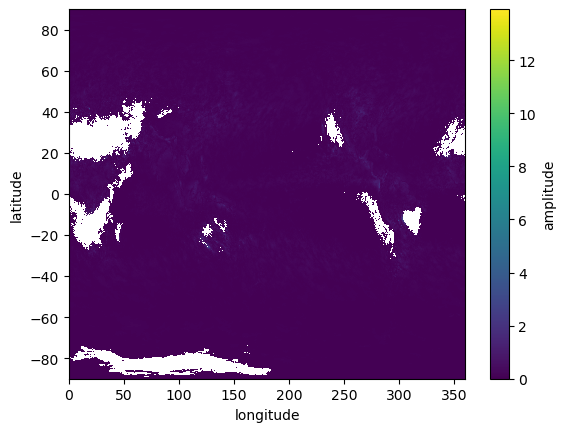

In [244]:
mswep['amplitude'].plot()

In [245]:
mswep_mean

<xarray.DataArray (latitude: 721, longitude: 1440)>
array([[0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.02781465, 0.02782425, 0.02783132, ..., 0.02753255, 0.02753569,
        0.        ],
       [0.02798043, 0.0281699 , 0.02815818, ..., 0.02801913, 0.02800602,
        0.        ],
       ...,
       [0.13308992, 0.13331576, 0.13292178, ..., 0.13108   , 0.13088276,
        0.        ],
       [0.13670715, 0.13660456, 0.13603095, ..., 0.137131  , 0.13765844,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ]])
Coordinates:
  * longitude  (longitude) float32 -179.8 -179.5 -179.2 ... 179.5 179.8 180.0
  * latitude   (latitude) float32 -90.0 -89.75 -89.5 -89.25 ... 89.5 89.75 90.0
Attributes:
    regrid_method:  bilinear

## figure

### Diurnal cycle

#### KIM

In [95]:
kim.to_netcdf('/home/gychoi/Python/Lab/output_file/중요/class_data/KIM_complete.nc')
#amplitude, norm_amplitude,mean 전부 들어있음 2021~2022

In [88]:
kim['daily_mean'] = kim_mean

In [90]:
kim['norm_amp'] = kim['amplitude']/kim['daily_mean']

In [91]:
amp30 = kim['norm_amp'].quantile(0.3, dim=['latitude','longitude']) 

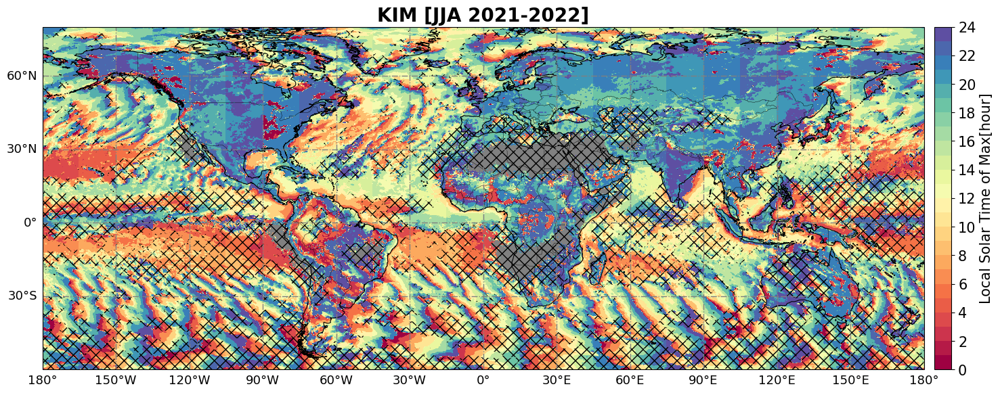

In [92]:
with ProgressBar():# 이게 제대로 된거임
    #utc
    nan_mask = np.isnan(kim['amplitude']) 
    hatch_mask = ((kim['norm_amp'].where(kim['daily_mean']>0.275)<amp30.values) | (kim['daily_mean']<0.275))
    tick_spacing = 30

    projection = ccrs.PlateCarree()
    crs = ccrs.PlateCarree()
    fig = plt.figure(figsize=(20,10))
    ax = plt.axes(projection=projection, frameon=True)


    varMin, varMax, varInt = 0, 24, 1
    levels = np.arange(varMin, varMax+varInt, varInt)
    nlevs  = levels.size
    tick_interval = 2
    cmap = plt.get_cmap('Spectral', nlevs)
    extent=[-180, 180, -60, 80]
    gl = ax.gridlines(crs=crs, draw_labels=True, linewidth=1, color='gray', alpha=1, linestyle='-.')
    gl.xlabel_style = {"size" : 13}
    gl.ylabel_style = {"size" : 13}
    gl.xlocator = mticker.FixedLocator(np.arange(extent[0], extent[1] + tick_spacing, tick_spacing))
    gl.ylocator = mticker.FixedLocator(np.arange(extent[2], extent[3] + tick_spacing, tick_spacing))

    ax.xaxis.set_major_formatter(LongitudeFormatter())
    ax.yaxis.set_major_formatter(LatitudeFormatter()) 

    gl.top_labels = None
    gl.right_labels = None

    ax.add_feature(cfeature.COASTLINE.with_scale("50m"), lw=0.8)
    ax.add_feature(cfeature.OCEAN.with_scale("50m"), edgecolor='none', facecolor='lightgray')
    ax.add_feature(cfeature.BORDERS.with_scale("50m"), lw=0.3)
    ax.set_extent([-180, 180, -60, 80], crs=ccrs.PlateCarree())

    lons = kim['longitude']  # 경도
    lats = kim['latitude']  # 위도
    values = kim['lst']

    lons, lats = np.meshgrid(kim['longitude'], kim['latitude'])

    cnplot = ax.contourf(lons, lats, values,cmap=cmap,levels=levels,zorder=0,transform=ccrs.PlateCarree())

    cbar = plt.colorbar(cnplot,ticks=np.arange(varMin, varMax+tick_interval, tick_interval), 
                        orientation='vertical', pad=0.01, shrink=.658) 
    
    ax.contourf(
        lons, lats, (nan_mask==True),
        transform=ccrs.PlateCarree(),
        colors='gray',
        levels=[0.5, 1.5],
    ) ## 이거 써야지 제대로 됨
    
    
    ax.contourf(
        lons, lats, hatch_mask,
        transform=ccrs.PlateCarree(),
        colors='none',
        levels=[0.5,1.5],
        hatches=['xx'],
    ) ## 이거 써야지 제대로 됨

    cbar.set_label('Local Solar Time of Max[hour]', fontsize=15)
    cbar.ax.tick_params(labelsize=15)

    plt.xlabel('Longitude',fontsize=10,fontweight='bold')
    plt.ylabel('Latitude',fontsize=10,fontweight='bold')    
    ax.set_title('KIM [JJA 2021-2022]',fontsize=20,fontweight='bold')
    plt.show()


In [255]:
kim_mean=grid_transfer(D['tpr'].mean('hour'))# 임시 새로 만들어 줘야함

In [113]:
kim_mean=regrid(kim_mean,era_mean)

In [85]:
kim_mean=grid_transfer(kim_mean)

In [260]:
kim=grid_transfer(kim)

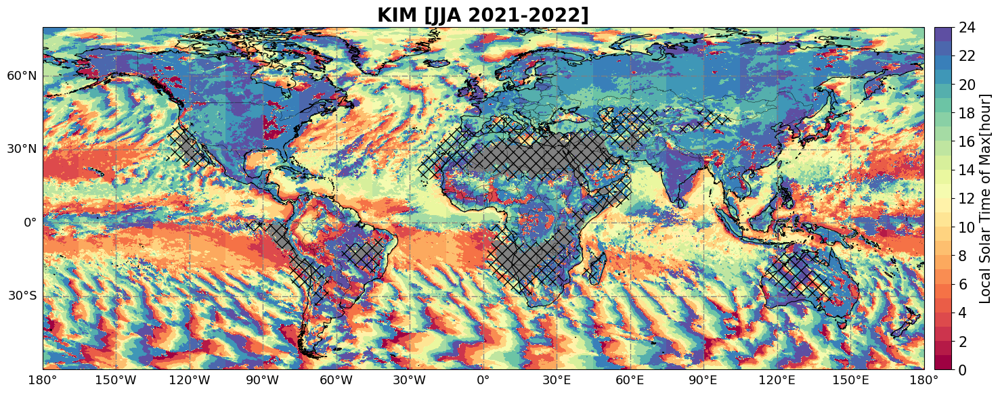

In [85]:
with ProgressBar():# 이거 좋네?
    #utc
    nan_mask = np.isnan(kim['amplitude']) 
    tick_spacing = 30

    projection = ccrs.PlateCarree()
    crs = ccrs.PlateCarree()
    fig = plt.figure(figsize=(20,10))
    ax = plt.axes(projection=projection, frameon=True)


    varMin, varMax, varInt = 0, 24, 1
    levels = np.arange(varMin, varMax+varInt, varInt)
    nlevs  = levels.size
    tick_interval = 2
    cmap = plt.get_cmap('Spectral', nlevs)
    extent=[-180, 180, -60, 80]
    gl = ax.gridlines(crs=crs, draw_labels=True, linewidth=1, color='gray', alpha=1, linestyle='-.')
    gl.xlabel_style = {"size" : 13}
    gl.ylabel_style = {"size" : 13}
    gl.xlocator = mticker.FixedLocator(np.arange(extent[0], extent[1] + tick_spacing, tick_spacing))
    gl.ylocator = mticker.FixedLocator(np.arange(extent[2], extent[3] + tick_spacing, tick_spacing))

    ax.xaxis.set_major_formatter(LongitudeFormatter())
    ax.yaxis.set_major_formatter(LatitudeFormatter()) 

    gl.top_labels = None
    gl.right_labels = None

    ax.add_feature(cfeature.COASTLINE.with_scale("50m"), lw=0.8)
    ax.add_feature(cfeature.OCEAN.with_scale("50m"), edgecolor='none', facecolor='lightgray')
    ax.add_feature(cfeature.BORDERS.with_scale("50m"), lw=0.3)
    ax.set_extent([-180, 180, -60, 80], crs=ccrs.PlateCarree())

    lons = kim['longitude']  # 경도
    lats = kim['latitude']  # 위도
    values = kim['lst']

    lons, lats = np.meshgrid(kim['longitude'], kim['latitude'])

    cnplot = ax.contourf(lons, lats, values,cmap=cmap,levels=levels,zorder=0,transform=ccrs.PlateCarree())

    cbar = plt.colorbar(cnplot,ticks=np.arange(varMin, varMax+tick_interval, tick_interval), 
                        orientation='vertical', pad=0.01, shrink=.658) 

    ax.contourf(
        lons, lats, (nan_mask==True),
        transform=ccrs.PlateCarree(),
        colors='gray',
        levels=[0.5, 1.5],
    ) ## 이거 써야지 제대로 됨
    
    
    ax.contourf(
        lons, lats, (kim_mean<0.275),
        transform=ccrs.PlateCarree(),
        colors='none',
        levels=[0.5, 1.5],
        hatches=['xx'],
    ) ## 이거 써야지 제대로 됨

    cbar.set_label('Local Solar Time of Max[hour]', fontsize=15)
    cbar.ax.tick_params(labelsize=15)

    plt.xlabel('Longitude',fontsize=10,fontweight='bold')
    plt.ylabel('Latitude',fontsize=10,fontweight='bold')    
    ax.set_title('KIM [JJA 2021-2022]',fontsize=20,fontweight='bold')
    plt.show()


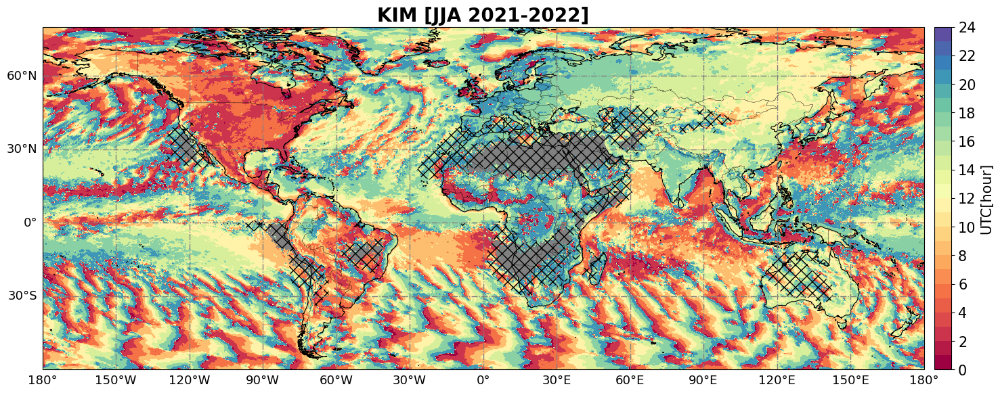

In [84]:
with ProgressBar():# 이거 좋네?
    #lst
    nan_mask = np.isnan(kim['amplitude']) 
    tick_spacing = 30

    projection = ccrs.PlateCarree()
    crs = ccrs.PlateCarree()
    fig = plt.figure(figsize=(20,10))
    ax = plt.axes(projection=projection, frameon=True)


    varMin, varMax, varInt = 0, 24, 1
    levels = np.arange(varMin, varMax+varInt, varInt)
    nlevs  = levels.size
    tick_interval = 2
    cmap = plt.get_cmap('Spectral', nlevs)
    extent=[-180, 180, -60, 80]
    gl = ax.gridlines(crs=crs, draw_labels=True, linewidth=1, color='gray', alpha=1, linestyle='-.')
    gl.xlabel_style = {"size" : 13}
    gl.ylabel_style = {"size" : 13}
    gl.xlocator = mticker.FixedLocator(np.arange(extent[0], extent[1] + tick_spacing, tick_spacing))
    gl.ylocator = mticker.FixedLocator(np.arange(extent[2], extent[3] + tick_spacing, tick_spacing))

    ax.xaxis.set_major_formatter(LongitudeFormatter())
    ax.yaxis.set_major_formatter(LatitudeFormatter()) 

    gl.top_labels = None
    gl.right_labels = None

    ax.add_feature(cfeature.COASTLINE.with_scale("50m"), lw=0.8)
    ax.add_feature(cfeature.OCEAN.with_scale("50m"), edgecolor='none', facecolor='lightgray')
    ax.add_feature(cfeature.BORDERS.with_scale("50m"), lw=0.3)
    ax.set_extent([-180, 180, -60, 80], crs=ccrs.PlateCarree())

    lons = kim['longitude']  # 경도
    lats = kim['latitude']  # 위도
    values = kim['utc']

    lons, lats = np.meshgrid(kim['longitude'], kim['latitude'])

    cnplot = ax.contourf(lons, lats, values,cmap=cmap,levels=levels,zorder=0,transform=ccrs.PlateCarree())

    cbar = plt.colorbar(cnplot,ticks=np.arange(varMin, varMax+tick_interval, tick_interval), 
                        orientation='vertical', pad=0.01, shrink=.658) 

    ax.contourf(
        lons, lats, (nan_mask==True),
        transform=ccrs.PlateCarree(),
        colors='gray',
        levels=[0.5, 1.5],
    ) ## 이거 써야지 제대로 됨
    
    
    ax.contourf(
        lons, lats, (kim_mean<0.275),
        transform=ccrs.PlateCarree(),
        colors='none',
        levels=[0.5, 1.5],
        hatches=['xx'],
    ) ## 이거 써야지 제대로 됨

    cbar.set_label('UTC[hour]', fontsize=15)
    cbar.ax.tick_params(labelsize=15)

    plt.xlabel('Longitude',fontsize=10,fontweight='bold')
    plt.ylabel('Latitude',fontsize=10,fontweight='bold')    
    ax.set_title('KIM [JJA 2021-2022]',fontsize=20,fontweight='bold')
    plt.show()


#### ERA5

In [63]:
era_mean=grid_transfer(era_mean)

In [150]:
era=grid_transfer(era)

In [280]:
nan_mask = np.isnan(era_amp['amplitude'])  


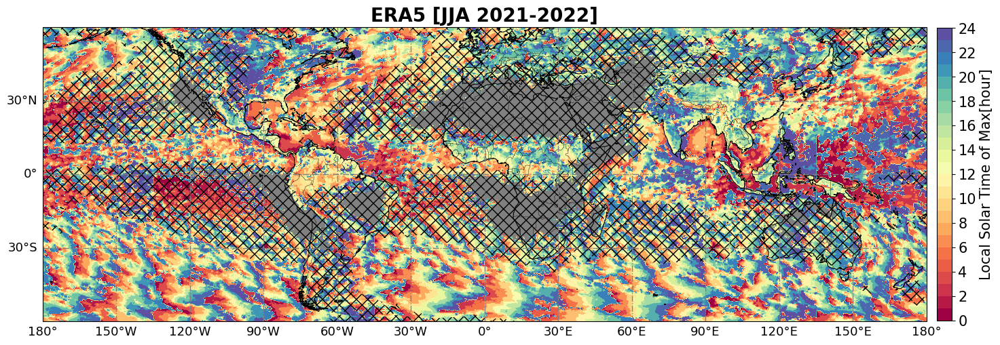

In [504]:
with ProgressBar():# 이거 좋네?
    #utc
    nan_mask = np.isnan(era['amplitude'])  
    tick_spacing = 30

    projection = ccrs.PlateCarree()
    crs = ccrs.PlateCarree()
    fig = plt.figure(figsize=(20,10))
    ax = plt.axes(projection=projection, frameon=True)


    varMin, varMax, varInt = 0, 24, 1
    levels = np.arange(varMin, varMax+varInt, varInt)
    nlevs  = levels.size
    tick_interval = 2
    cmap = plt.get_cmap('Spectral', nlevs)
    extent=[-180, 180, -60, 60]
    gl = ax.gridlines(crs=crs, draw_labels=True, linewidth=1, color='gray', alpha=1, linestyle='-.')
    gl.xlabel_style = {"size" : 13}
    gl.ylabel_style = {"size" : 13}
    gl.xlocator = mticker.FixedLocator(np.arange(extent[0], extent[1] + tick_spacing, tick_spacing))
    gl.ylocator = mticker.FixedLocator(np.arange(extent[2], extent[3] + tick_spacing, tick_spacing))

    ax.xaxis.set_major_formatter(LongitudeFormatter())
    ax.yaxis.set_major_formatter(LatitudeFormatter()) 

    gl.top_labels = None
    gl.right_labels = None

    ax.add_feature(cfeature.COASTLINE.with_scale("50m"), lw=0.8)
    ax.add_feature(cfeature.OCEAN.with_scale("50m"), edgecolor='none', facecolor='lightgray')
    ax.add_feature(cfeature.BORDERS.with_scale("50m"), lw=0.3)
    ax.set_extent([-180, 180, -60, 60], crs=ccrs.PlateCarree())

    lons = era['longitude']  # 경도
    lats = era['latitude']  # 위도
    values = era['lst']

    lons, lats = np.meshgrid(era['longitude'], era['latitude'])

    cnplot = ax.contourf(lons, lats, values,cmap=cmap,levels=levels,zorder=0,transform=ccrs.PlateCarree())

    cbar = plt.colorbar(cnplot,ticks=np.arange(varMin, varMax+tick_interval, tick_interval), 
                        orientation='vertical', pad=0.01, shrink=.56) 
    
    ax.contourf(
        lons, lats, (nan_mask==True),
        transform=ccrs.PlateCarree(),
        colors='gray',
        levels=[0.5, 1.5],
    ) ## 이거 써야지 제대로 됨
    
    
    ax.contourf(
        lons, lats, (era_mean<0.275),
        transform=ccrs.PlateCarree(),
        colors='none',
        levels=[0.5, 1.5],
        hatches=['xx'],
    ) ## 이거 써야지 제대로 됨

    cbar.set_label('Local Solar Time of Max[hour]', fontsize=15)
    cbar.ax.tick_params(labelsize=15)

    plt.xlabel('Longitude',fontsize=10,fontweight='bold')
    plt.ylabel('Latitude',fontsize=10,fontweight='bold')    
    ax.set_title('ERA5 [JJA 2021-2022]',fontsize=20,fontweight='bold')
    plt.show()


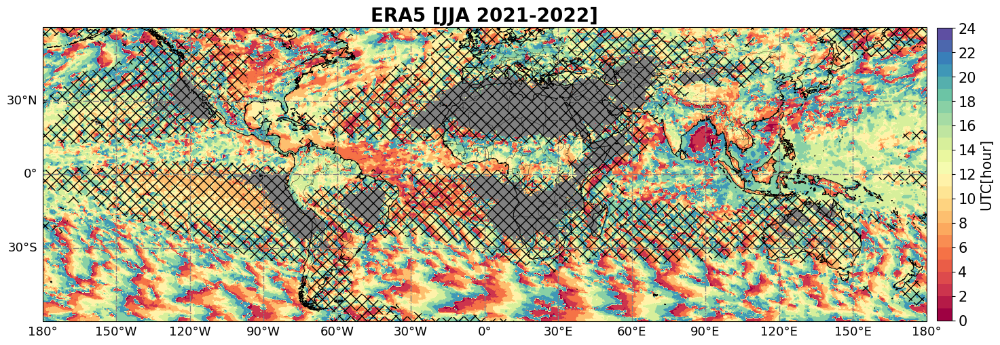

In [505]:
with ProgressBar():# 이거 좋네?
    #utc
    nan_mask = np.isnan(era_amp['amplitude'])  
    tick_spacing = 30

    projection = ccrs.PlateCarree()
    crs = ccrs.PlateCarree()
    fig = plt.figure(figsize=(20,10))
    ax = plt.axes(projection=projection, frameon=True)


    varMin, varMax, varInt = 0, 24, 1
    levels = np.arange(varMin, varMax+varInt, varInt)
    nlevs  = levels.size
    tick_interval = 2
    cmap = plt.get_cmap('Spectral', nlevs)
    extent=[-180, 180, -60, 60]
    gl = ax.gridlines(crs=crs, draw_labels=True, linewidth=1, color='gray', alpha=1, linestyle='-.')
    gl.xlabel_style = {"size" : 13}
    gl.ylabel_style = {"size" : 13}
    gl.xlocator = mticker.FixedLocator(np.arange(extent[0], extent[1] + tick_spacing, tick_spacing))
    gl.ylocator = mticker.FixedLocator(np.arange(extent[2], extent[3] + tick_spacing, tick_spacing))

    ax.xaxis.set_major_formatter(LongitudeFormatter())
    ax.yaxis.set_major_formatter(LatitudeFormatter()) 

    gl.top_labels = None
    gl.right_labels = None

    ax.add_feature(cfeature.COASTLINE.with_scale("50m"), lw=0.8)
    ax.add_feature(cfeature.OCEAN.with_scale("50m"), edgecolor='none', facecolor='lightgray')
    ax.add_feature(cfeature.BORDERS.with_scale("50m"), lw=0.3)
    ax.set_extent([-180, 180, -60, 60], crs=ccrs.PlateCarree())

    lons = era['longitude']  # 경도
    lats = era['latitude']  # 위도
    values = era['utc']

    lons, lats = np.meshgrid(era['longitude'], era['latitude'])

    cnplot = ax.contourf(lons, lats, values,cmap=cmap,levels=levels,zorder=0,transform=ccrs.PlateCarree())

    cbar = plt.colorbar(cnplot,ticks=np.arange(varMin, varMax+tick_interval, tick_interval), 
                        orientation='vertical', pad=0.01, shrink=.56) 
    
    ax.contourf(
        lons, lats, (nan_mask==True),
        transform=ccrs.PlateCarree(),
        colors='gray',
        levels=[0.5, 1.5],
    ) ## 이거 써야지 제대로 됨
    
    
    ax.contourf(
        lons, lats, (era_mean<0.275),
        transform=ccrs.PlateCarree(),
        colors='none',
        levels=[0.5, 1.5],
        hatches=['xx'],
    ) ## 이거 써야지 제대로 됨

    cbar.set_label('UTC[hour]', fontsize=15)
    cbar.ax.tick_params(labelsize=15)

    plt.xlabel('Longitude',fontsize=10,fontweight='bold')
    plt.ylabel('Latitude',fontsize=10,fontweight='bold')    
    ax.set_title('ERA5 [JJA 2021-2022]',fontsize=20,fontweight='bold')
    plt.show()


#### MSWEP

In [71]:
mswep_mean=grid_transfer(mswep_mean)

In [72]:
mswep_mean

<xarray.DataArray 'precipitation' (latitude: 1440, longitude: 2880)>
[4147200 values with dtype=float64]
Coordinates:
  * longitude  (longitude) float64 -179.9 -179.8 -179.6 ... 179.8 179.9 180.0
  * latitude   (latitude) float64 -89.94 -89.81 -89.69 ... 89.69 89.81 89.94

In [74]:
mswep['daily_mean'] = mswep_mean

In [75]:
mswep['norm_amp'] = mswep['amplitude']/mswep['daily_mean']

In [96]:
mswep

<xarray.Dataset>
Dimensions:     (latitude: 1440, longitude: 2880)
Coordinates:
  * latitude    (latitude) float64 -89.94 -89.81 -89.69 ... 89.69 89.81 89.94
  * longitude   (longitude) float64 -179.9 -179.8 -179.6 ... 179.8 179.9 180.0
Data variables:
    utc         (latitude, longitude) float64 ...
    lst         (latitude, longitude) float64 21.01 21.02 21.02 ... 2.992 12.0
    amplitude   (latitude, longitude) float64 0.005687 0.005656 ... 0.008953 0.0
    daily_mean  (latitude, longitude) float64 0.2102 0.2096 0.2096 ... 1.049 0.0
    norm_amp    (latitude, longitude) float64 0.02706 0.02699 ... 0.008537 nan

In [80]:
amp30 = mswep['norm_amp'].quantile(0.4, dim=['latitude','longitude']) 

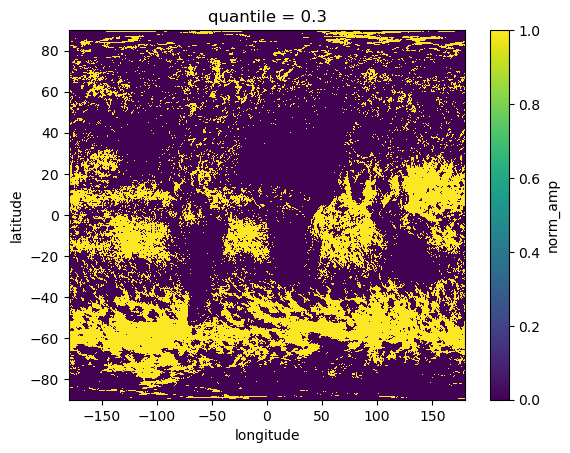

In [78]:
(mswep['norm_amp']<amp30).plot()

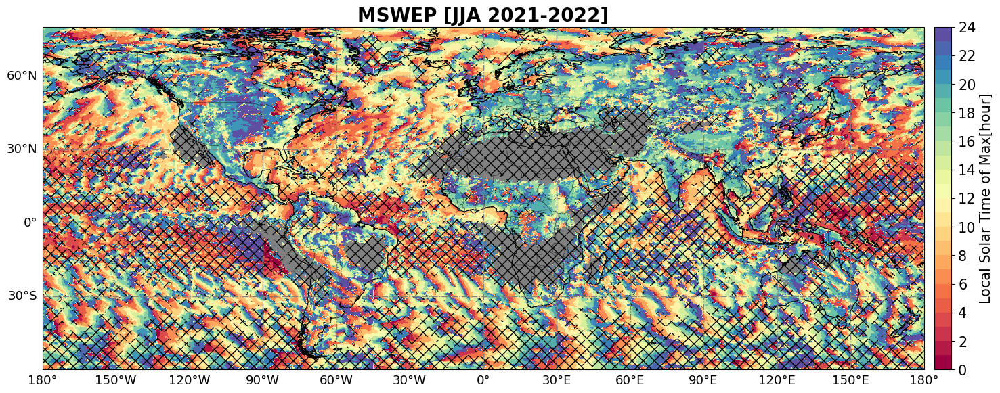

In [81]:
with ProgressBar():# 이게 제대로 된거임
    #utc
    nan_mask = np.isnan(mswep['amplitude']) 
    hatch_mask = ((mswep['norm_amp'].where(mswep['daily_mean']>0.275)<amp30.values) | (mswep['daily_mean']<0.275))
    tick_spacing = 30

    projection = ccrs.PlateCarree()
    crs = ccrs.PlateCarree()
    fig = plt.figure(figsize=(20,10))
    ax = plt.axes(projection=projection, frameon=True)


    varMin, varMax, varInt = 0, 24, 1
    levels = np.arange(varMin, varMax+varInt, varInt)
    nlevs  = levels.size
    tick_interval = 2
    cmap = plt.get_cmap('Spectral', nlevs)
    extent=[-180, 180, -60, 80]
    gl = ax.gridlines(crs=crs, draw_labels=True, linewidth=1, color='gray', alpha=1, linestyle='-.')
    gl.xlabel_style = {"size" : 13}
    gl.ylabel_style = {"size" : 13}
    gl.xlocator = mticker.FixedLocator(np.arange(extent[0], extent[1] + tick_spacing, tick_spacing))
    gl.ylocator = mticker.FixedLocator(np.arange(extent[2], extent[3] + tick_spacing, tick_spacing))

    ax.xaxis.set_major_formatter(LongitudeFormatter())
    ax.yaxis.set_major_formatter(LatitudeFormatter()) 

    gl.top_labels = None
    gl.right_labels = None

    ax.add_feature(cfeature.COASTLINE.with_scale("50m"), lw=0.8)
    ax.add_feature(cfeature.OCEAN.with_scale("50m"), edgecolor='none', facecolor='lightgray')
    ax.add_feature(cfeature.BORDERS.with_scale("50m"), lw=0.3)
    ax.set_extent([-180, 180, -60, 80], crs=ccrs.PlateCarree())

    lons = mswep['longitude']  # 경도
    lats = mswep['latitude']  # 위도
    values = mswep['lst']

    lons, lats = np.meshgrid(mswep['longitude'], mswep['latitude'])

    cnplot = ax.contourf(lons, lats, values,cmap=cmap,levels=levels,zorder=0,transform=ccrs.PlateCarree())

    cbar = plt.colorbar(cnplot,ticks=np.arange(varMin, varMax+tick_interval, tick_interval), 
                        orientation='vertical', pad=0.01, shrink=.658) 
    
    ax.contourf(
        lons, lats, (nan_mask==True),
        transform=ccrs.PlateCarree(),
        colors='gray',
        levels=[0.5, 1.5],
    ) ## 이거 써야지 제대로 됨
    
    
    ax.contourf(
        lons, lats, hatch_mask,
        transform=ccrs.PlateCarree(),
        colors='none',
        levels=[0.5,1.5],
        hatches=['xx'],
    ) ## 이거 써야지 제대로 됨

    cbar.set_label('Local Solar Time of Max[hour]', fontsize=15)
    cbar.ax.tick_params(labelsize=15)

    plt.xlabel('Longitude',fontsize=10,fontweight='bold')
    plt.ylabel('Latitude',fontsize=10,fontweight='bold')    
    ax.set_title('MSWEP [JJA 2021-2022]',fontsize=20,fontweight='bold')
    plt.show()


In [267]:
mswep=grid_transfer(mswep)

In [436]:
mswep_mean1=E['precipitation'].mean('hour')

In [438]:
mswep_mean1 = grid_transfer(mswep_mean1)

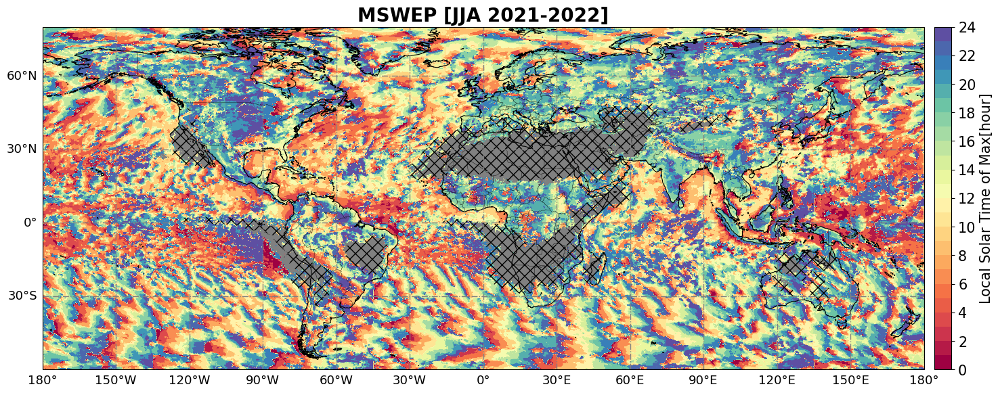

In [86]:
with ProgressBar():# 이거 좋네?
    #utc
    nan_mask = np.isnan(mswep['amplitude'])  
    tick_spacing = 30

    projection = ccrs.PlateCarree()
    crs = ccrs.PlateCarree()
    fig = plt.figure(figsize=(20,10))
    ax = plt.axes(projection=projection, frameon=True)


    varMin, varMax, varInt = 0, 24, 1
    levels = np.arange(varMin, varMax+varInt, varInt)
    nlevs  = levels.size
    tick_interval = 2
    cmap = plt.get_cmap('Spectral', nlevs)
    extent=[-180, 180, -60, 80]
    gl = ax.gridlines(crs=crs, draw_labels=True, linewidth=1, color='gray', alpha=1, linestyle='-.')
    gl.xlabel_style = {"size" : 13}
    gl.ylabel_style = {"size" : 13}
    gl.xlocator = mticker.FixedLocator(np.arange(extent[0], extent[1] + tick_spacing, tick_spacing))
    gl.ylocator = mticker.FixedLocator(np.arange(extent[2], extent[3] + tick_spacing, tick_spacing))

    ax.xaxis.set_major_formatter(LongitudeFormatter())
    ax.yaxis.set_major_formatter(LatitudeFormatter()) 

    gl.top_labels = None
    gl.right_labels = None

    ax.add_feature(cfeature.COASTLINE.with_scale("50m"), lw=0.8)
    ax.add_feature(cfeature.OCEAN.with_scale("50m"), edgecolor='none', facecolor='lightgray')
    ax.add_feature(cfeature.BORDERS.with_scale("50m"), lw=0.3)
    ax.set_extent([-180, 180, -60, 80], crs=ccrs.PlateCarree())

    lons = mswep['longitude']  # 경도
    lats = mswep['latitude']  # 위도
    values = mswep['lst']

    lons, lats = np.meshgrid(mswep['longitude'], mswep['latitude'])

    cnplot = ax.contourf(lons, lats, values,cmap=cmap,levels=levels,zorder=0,transform=ccrs.PlateCarree())

    cbar = plt.colorbar(cnplot,ticks=np.arange(varMin, varMax+tick_interval, tick_interval), 
                        orientation='vertical', pad=0.01, shrink=.658) 
    
    ax.contourf(
        lons, lats, (nan_mask==True),
        transform=ccrs.PlateCarree(),
        colors='gray',
        levels=[0.5, 1.5],
    ) ## 이거 써야지 제대로 됨
    
    
    ax.contourf(
        lons, lats, mswep_mean,
        transform=ccrs.PlateCarree(),
        colors='none',
        levels=[0,0.275],
        hatches=['xx'],
    ) ## 이거 써야지 제대로 됨

    cbar.set_label('Local Solar Time of Max[hour]', fontsize=15)
    cbar.ax.tick_params(labelsize=15)

    plt.xlabel('Longitude',fontsize=10,fontweight='bold')
    plt.ylabel('Latitude',fontsize=10,fontweight='bold')    
    ax.set_title('MSWEP [JJA 2021-2022]',fontsize=20,fontweight='bold')
    plt.show()


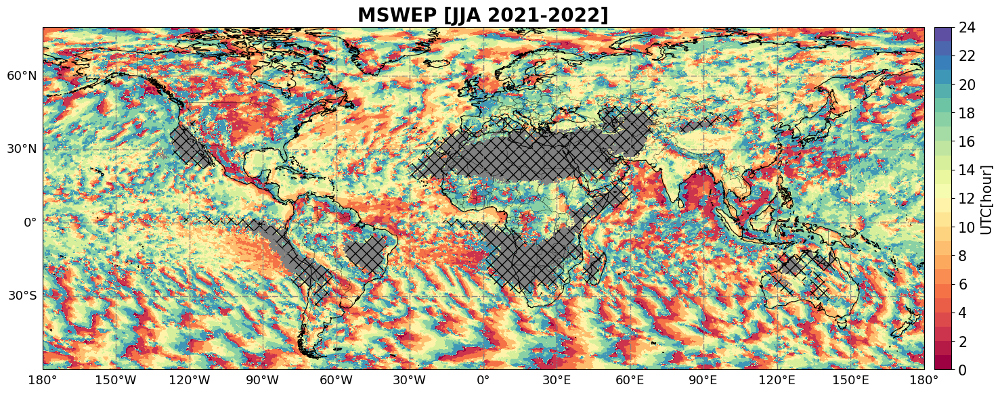

In [87]:
with ProgressBar():# 이거 좋네?
    #utc
    nan_mask = np.isnan(mswep['amplitude'])  
    tick_spacing = 30

    projection = ccrs.PlateCarree()
    crs = ccrs.PlateCarree()
    fig = plt.figure(figsize=(20,10))
    ax = plt.axes(projection=projection, frameon=True)


    varMin, varMax, varInt = 0, 24, 1
    levels = np.arange(varMin, varMax+varInt, varInt)
    nlevs  = levels.size
    tick_interval = 2
    cmap = plt.get_cmap('Spectral', nlevs)
    extent=[-180, 180, -60, 80]
    gl = ax.gridlines(crs=crs, draw_labels=True, linewidth=1, color='gray', alpha=1, linestyle='-.')
    gl.xlabel_style = {"size" : 13}
    gl.ylabel_style = {"size" : 13}
    gl.xlocator = mticker.FixedLocator(np.arange(extent[0], extent[1] + tick_spacing, tick_spacing))
    gl.ylocator = mticker.FixedLocator(np.arange(extent[2], extent[3] + tick_spacing, tick_spacing))

    ax.xaxis.set_major_formatter(LongitudeFormatter())
    ax.yaxis.set_major_formatter(LatitudeFormatter()) 

    gl.top_labels = None
    gl.right_labels = None

    ax.add_feature(cfeature.COASTLINE.with_scale("50m"), lw=0.8)
    ax.add_feature(cfeature.OCEAN.with_scale("50m"), edgecolor='none', facecolor='lightgray')
    ax.add_feature(cfeature.BORDERS.with_scale("50m"), lw=0.3)
    ax.set_extent([-180, 180, -60, 80], crs=ccrs.PlateCarree())

    lons = mswep['longitude']  # 경도
    lats = mswep['latitude']  # 위도
    values = mswep['utc']

    lons, lats = np.meshgrid(mswep['longitude'], mswep['latitude'])

    cnplot = ax.contourf(lons, lats, values,cmap=cmap,levels=levels,zorder=0,transform=ccrs.PlateCarree())

    cbar = plt.colorbar(cnplot,ticks=np.arange(varMin, varMax+tick_interval, tick_interval), 
                        orientation='vertical', pad=0.01, shrink=.658) 
    
    ax.contourf(
        lons, lats, (nan_mask==True),
        transform=ccrs.PlateCarree(),
        colors='gray',
        levels=[0.5, 1.5],
    ) ## 이거 써야지 제대로 됨
    
    
    ax.contourf(
        lons, lats, (mswep_mean<0.275),
        transform=ccrs.PlateCarree(),
        colors='none',
        levels=[0.5, 1.5],
        hatches=['xx'],
    ) ## 이거 써야지 제대로 됨

    cbar.set_label('UTC[hour]', fontsize=15)
    cbar.ax.tick_params(labelsize=15)

    plt.xlabel('Longitude',fontsize=10,fontweight='bold')
    plt.ylabel('Latitude',fontsize=10,fontweight='bold')    
    ax.set_title('MSWEP [JJA 2021-2022]',fontsize=20,fontweight='bold')
    plt.show()


### Amplitude

#### figure function

In [81]:
def amplitude_fig(data,data_source):

    nan_mask = np.isnan(data['amplitude'])  
    
    tick_spacing = 30
    projection = ccrs.PlateCarree()
    crs = ccrs.PlateCarree()
    fig = plt.figure(figsize=(20,10))
    ax = plt.axes(projection=projection, frameon=True)


    varMin, varMax, varInt = 0, 1, 0.05
    levels = np.arange(varMin, varMax+varInt, varInt)
    nlevs  = levels.size
    tick_interval = 0.1
    cmap = plt.get_cmap('plasma', nlevs)
    extent=[-180, 180, -60, 80]

    gl = ax.gridlines(crs=crs, draw_labels=True, linewidth=1, color='gray', alpha=1, linestyle='-.')
    gl.xlabel_style = {"size" : 13}
    gl.ylabel_style = {"size" : 13}
    gl.xlocator = mticker.FixedLocator(np.arange(extent[0], extent[1] + tick_spacing, tick_spacing))
    gl.ylocator = mticker.FixedLocator(np.arange(extent[2], extent[3] + tick_spacing, tick_spacing))

    ax.xaxis.set_major_formatter(LongitudeFormatter())
    ax.yaxis.set_major_formatter(LatitudeFormatter()) 

    gl.top_labels = None
    gl.right_labels = None

    ax.add_feature(cfeature.COASTLINE.with_scale("50m"), lw=0.8)
    ax.add_feature(cfeature.OCEAN.with_scale("50m"), edgecolor='none', facecolor='lightgray')
    ax.add_feature(cfeature.BORDERS.with_scale("50m"), lw=0.3)
    ax.set_extent([-180, 180, -60, 80], crs=ccrs.PlateCarree())

    lons = data['longitude']  # 경도
    lats = data['latitude']  # 위도
    values = data['amplitude']

    lons, lats = np.meshgrid(data['longitude'], data['latitude'])

    cnplot = ax.contourf(lons, lats, values,cmap=cmap,levels=levels,zorder=0,
                         transform=ccrs.PlateCarree(),extend='max')

    cbar = plt.colorbar(cnplot,ticks=np.arange(varMin, varMax+tick_interval, tick_interval), 
                        orientation='vertical', pad=0.01, shrink=.658) 

    ax.contourf(
        lons, lats, (nan_mask==True),
        transform=ccrs.PlateCarree(),
        colors='gray',
        levels=[0.5, 1.5],
    ) ## 이거 써야지 제대로 됨
    
    
    cbar.set_label('[mm/3h]', fontsize=15)
    cbar.ax.tick_params(labelsize=15)

    plt.xlabel('Longitude',fontsize=10,fontweight='bold')
    plt.ylabel('Latitude',fontsize=10,fontweight='bold')    
    ax.set_title(data_source+' [JJA 2021-2022]',fontsize=20,fontweight='bold')
    plt.savefig('/home/gychoi/Python/Lab/output_file/professor_file/' + data_source + '_Amplitude.png',format='png', dpi=200,bbox_inches='tight')

    plt.show()


#### KIM

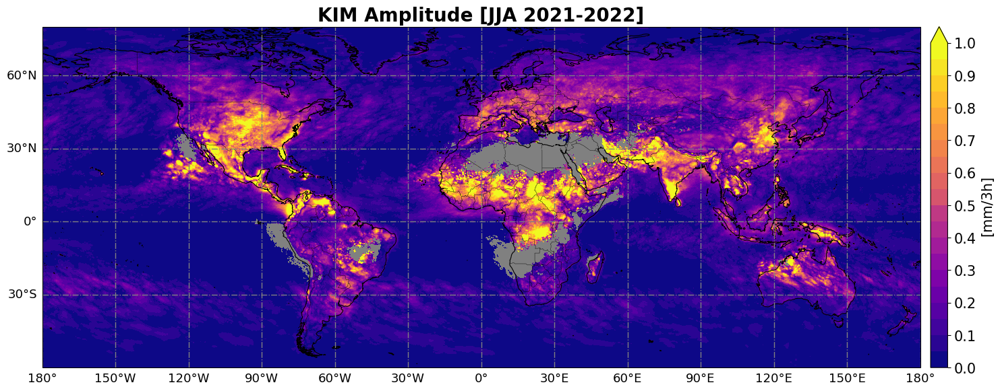

In [82]:
amplitude_fig(kim,'KIM Amplitude')

#### ERA5

In [171]:
era_amp=grid_transfer(era_amp)

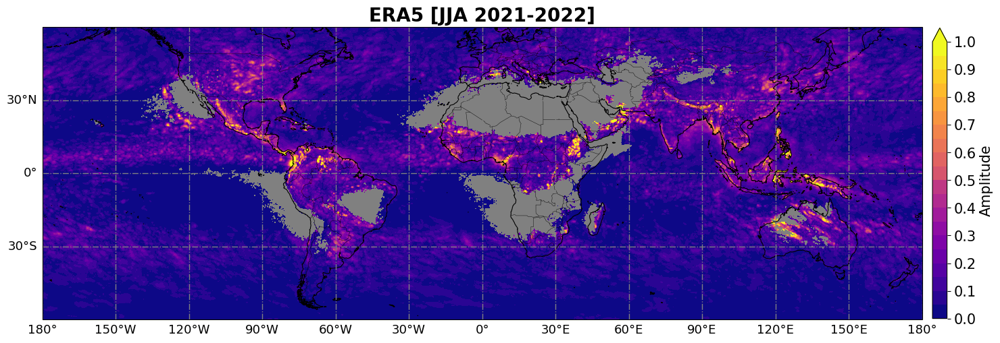

In [338]:
amplitude_fig(era_amp,'ERA5')

#### MSWEP

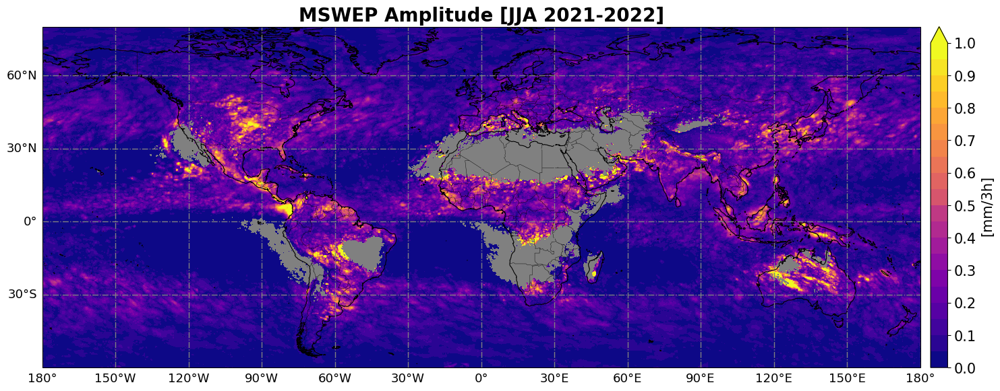

In [83]:
amplitude_fig(mswep,'MSWEP Amplitude')

### Taylor Skill Score
D=KIM  
b
E=MSWEP  

In [289]:
D

<xarray.Dataset>
Dimensions:    (longitude: 2880, latitude: 1440, hour: 8)
Coordinates:
  * longitude  (longitude) float64 0.0 0.125 0.25 0.375 ... 359.6 359.8 359.9
  * latitude   (latitude) float64 89.94 89.81 89.69 ... -89.69 -89.81 -89.94
  * hour       (hour) int64 0 3 6 9 12 15 18 21
Data variables:
    tpr        (hour, latitude, longitude) float64 0.4042 0.4041 ... 0.1866

In [286]:
E

<xarray.Dataset>
Dimensions:        (hour: 8, latitude: 1440, longitude: 2880)
Coordinates:
  * hour           (hour) int64 0 3 6 9 12 15 18 21
  * longitude      (longitude) float64 0.0 0.125 0.25 ... 359.6 359.8 359.9
  * latitude       (latitude) float64 89.94 89.81 89.69 ... -89.69 -89.81 -89.94
Data variables:
    precipitation  (hour, latitude, longitude) float64 0.4018 0.4017 ... 0.1717
Attributes:
    regrid_method:  bilinear

In [342]:
corr_cof=xr.corr(D['tpr'],E['precipitation'],'hour')

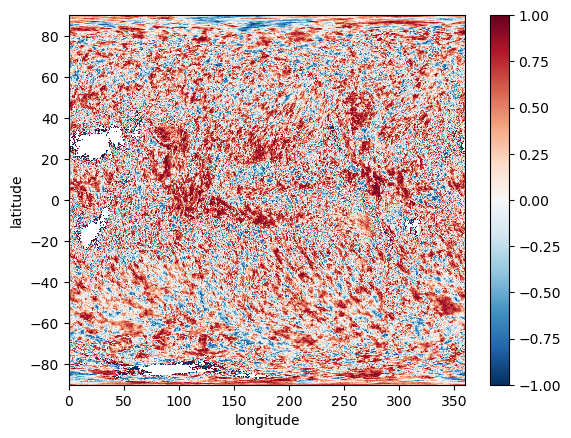

In [344]:
corr_cof.plot()

In [345]:
kim_std = D['tpr'].std('hour')

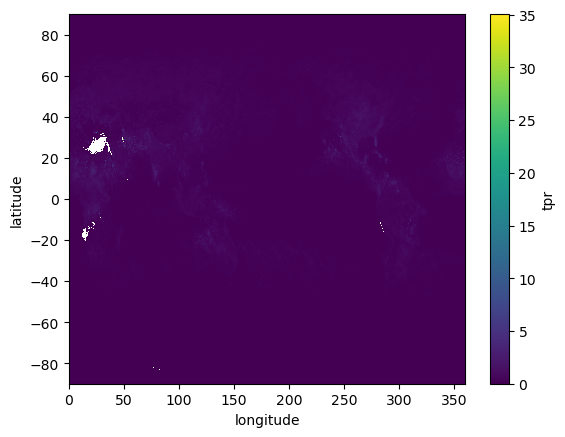

In [349]:
kim_std.plot()

In [347]:
mswep_std = E['precipitation'].std('hour')

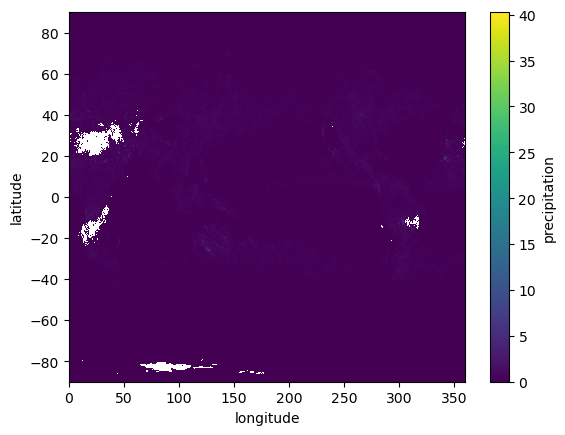

In [350]:
mswep_std.plot()

In [351]:
std = kim_std/mswep_std

In [355]:
TSS = (4*(1+corr_cof)**4)/(((std+1/std)**2)*(1+1)**4)

In [359]:
TSS=grid_transfer(TSS)

In [378]:
corr_cof.max()

<xarray.DataArray ()>
array(1.)

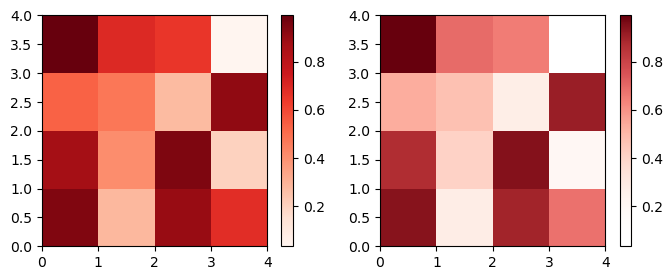

In [65]:
import numpy as np
import matplotlib.pylab as pl
from matplotlib.colors import ListedColormap

# Random data
data1 = np.random.random((4,4))

# Choose colormap which will be mixed with the alpha values
cmap = pl.cm.Reds

# Get the colormap colors
my_cmap = cmap(np.arange(cmap.N))
# Define the alphas in the range from 0 to 1
alphas = np.linspace(0, 1, cmap.N)
# Define the background as white
BG = np.asarray([1., 1., 1.,])
# Mix the colors with the background
for i in range(cmap.N):
    my_cmap[i,:-1] = my_cmap[i,:-1] * alphas[i] + BG * (1.-alphas[i])
# Create new colormap which mimics the alpha values
my_cmap = ListedColormap(my_cmap)

# Plot
f, axs = pl.subplots(1,2, figsize=(8,3))
h = axs[0].pcolormesh(data1, cmap=pl.cm.Reds)
cb = f.colorbar(h, ax=axs[0])

h = axs[1].pcolormesh(data1, cmap=my_cmap)
cb = pl.colorbar(h, ax=axs[1])
f.show()

In [8]:
def TSS_fig(data,data_source):

    nan_mask = np.isnan(TSS)  
    
    tick_spacing = 30
    projection = ccrs.PlateCarree()
    crs = ccrs.PlateCarree()
    fig = plt.figure(figsize=(20,10))
    ax = plt.axes(projection=projection, frameon=True)


    varMin, varMax, varInt = 0, 0.8, 0.05
    levels = np.arange(varMin, varMax+varInt, varInt)
    nlevs  = levels.size
    tick_interval = 0.1
    cmap = my_cmap #plt.get_cmap('jet', nlevs)
    extent=[-180, 180, -60, 60]

    gl = ax.gridlines(crs=crs, draw_labels=True, linewidth=1, color='gray', alpha=1, linestyle='-.')
    gl.xlabel_style = {"size" : 13}
    gl.ylabel_style = {"size" : 13}
    gl.xlocator = mticker.FixedLocator(np.arange(extent[0], extent[1] + tick_spacing, tick_spacing))
    gl.ylocator = mticker.FixedLocator(np.arange(extent[2], extent[3] + tick_spacing, tick_spacing))

    ax.xaxis.set_major_formatter(LongitudeFormatter())
    ax.yaxis.set_major_formatter(LatitudeFormatter()) 

    gl.top_labels = None
    gl.right_labels = None

    ax.add_feature(cfeature.COASTLINE.with_scale("50m"), lw=0.8)
    ax.add_feature(cfeature.OCEAN.with_scale("50m"), edgecolor='none', facecolor='lightgray')
    ax.add_feature(cfeature.BORDERS.with_scale("50m"), lw=0.3)
    ax.set_extent([-180, 180, -60, 60], crs=ccrs.PlateCarree())

    lons = data['longitude']  # 경도
    lats = data['latitude']  # 위도
    values = data

    lons, lats = np.meshgrid(data['longitude'], data['latitude'])

    cnplot = ax.contourf(lons, lats, values,cmap=cmap,levels=levels,zorder=0,
                         transform=ccrs.PlateCarree(),extend='max')
    #extend = 'max'
    cbar = plt.colorbar(cnplot,ticks=np.arange(varMin, varMax+tick_interval, tick_interval), 
                        orientation='vertical', pad=0.01, shrink=.56) 

    ax.contourf(
        lons, lats, (nan_mask==True),
        transform=ccrs.PlateCarree(),
        colors='gray',
        levels=[0.5, 1.5],
    )
    
    
    cbar.set_label('TSS', fontsize=15)
    cbar.ax.tick_params(labelsize=15)

    plt.xlabel('Longitude',fontsize=10,fontweight='bold')
    plt.ylabel('Latitude',fontsize=10,fontweight='bold')    
    ax.set_title(data_source+' [JJA 2021-2022]',fontsize=20,fontweight='bold')
    plt.show()


In [93]:
TSS=xr.open_dataarray('/home/gychoi/Python/Lab/output_file/professor_file/TSS.nc')

In [94]:
import scipy.ndimage as ndimage


# 필터 크기를 설정하여 공간적 평활화 수행
smoothed_data = ndimage.gaussian_filter(TSS, sigma=1.0)


In [28]:
smoothed_data

array([[0.36470938, 0.37570542, 0.37786353, ...,        nan,        nan,
               nan],
       [0.3964713 , 0.40069143, 0.40158434, ...,        nan,        nan,
               nan],
       [0.40071146, 0.40273316, 0.41074701, ...,        nan,        nan,
               nan],
       ...,
       [0.03169066, 0.02832058, 0.02714756, ...,        nan,        nan,
               nan],
       [0.07775016, 0.07396645, 0.07229561, ...,        nan,        nan,
               nan],
       [0.1443057 , 0.14237999, 0.14130134, ...,        nan,        nan,
               nan]])

IndexError: only integers, slices (`:`), ellipsis (`...`), numpy.newaxis (`None`) and integer or boolean arrays are valid indices

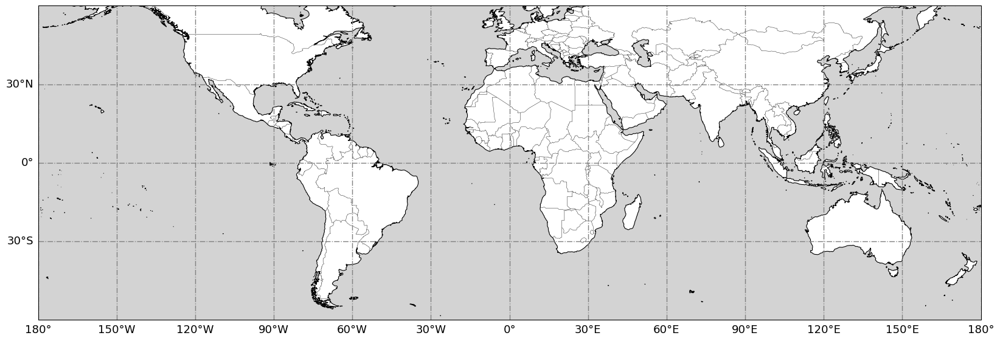

In [14]:
with ProgressBar():
    
    TSS_fig(smoothed_data,'Taylor Skill Score [KIM-MSWEP]')

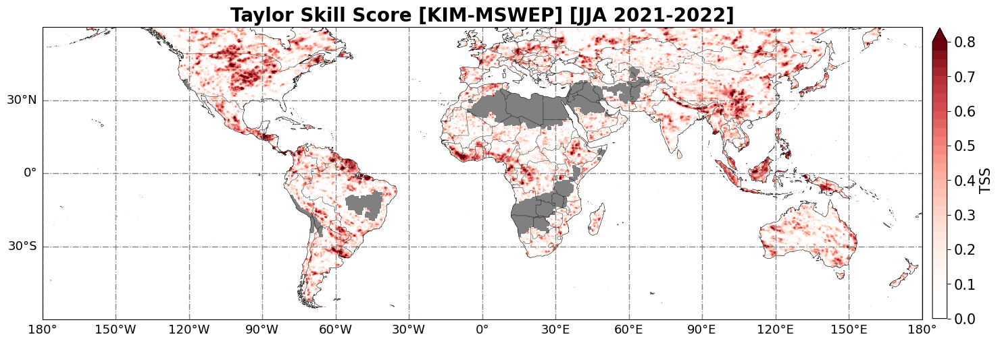

In [66]:
#def TSS_fig(data,data_source):
data = TSS
nan_mask = np.isnan(smoothed_data)  

tick_spacing = 30
projection = ccrs.PlateCarree()
crs = ccrs.PlateCarree()
fig = plt.figure(figsize=(20,10))
ax = plt.axes(projection=projection, frameon=True)


varMin, varMax, varInt = 0, 0.8, 0.025
levels = np.arange(varMin, varMax+varInt, varInt)
nlevs  = levels.size
tick_interval = 0.1
cmap = my_cmap#plt.get_cmap('Reds', nlevs)
extent=[-180, 180, -60, 60]

gl = ax.gridlines(crs=crs, draw_labels=True, linewidth=1, color='gray', alpha=1, linestyle='-.')
gl.xlabel_style = {"size" : 13}
gl.ylabel_style = {"size" : 13}
gl.xlocator = mticker.FixedLocator(np.arange(extent[0], extent[1] + tick_spacing, tick_spacing))
gl.ylocator = mticker.FixedLocator(np.arange(extent[2], extent[3] + tick_spacing, tick_spacing))

ax.xaxis.set_major_formatter(LongitudeFormatter())
ax.yaxis.set_major_formatter(LatitudeFormatter()) 

gl.top_labels = None
gl.right_labels = None

ax.add_feature(cfeature.COASTLINE.with_scale("50m"), lw=0.8)
#ax.add_feature(cfeature.OCEAN.with_scale("50m"), edgecolor='none', facecolor='lightgray')
ax.add_feature(cfeature.BORDERS.with_scale("50m"), lw=0.3)
ax.set_extent([-180, 180, -60, 60], crs=ccrs.PlateCarree())

lons = data['longitude']  # 경도
lats = data['latitude']  # 위도
values = smoothed_data

lons, lats = np.meshgrid(data['longitude'], data['latitude'])

cnplot = ax.contourf(lons, lats, values,cmap=cmap,levels=levels,zorder=0,
                     transform=ccrs.PlateCarree(),extend='max')
#extend = 'max'
cbar = plt.colorbar(cnplot,ticks=np.arange(varMin, varMax+tick_interval, tick_interval), 
                    orientation='vertical', pad=0.01, shrink=.56) 

ax.contourf(
    lons, lats, (nan_mask==True),
    transform=ccrs.PlateCarree(),
    colors='gray',
    levels=[0.5, 1.5],
)

cbar.set_label('TSS', fontsize=15)
cbar.ax.tick_params(labelsize=15)

plt.xlabel('Longitude',fontsize=10,fontweight='bold')
plt.ylabel('Latitude',fontsize=10,fontweight='bold')    
ax.set_title('Taylor Skill Score [KIM-MSWEP]'+' [JJA 2021-2022]',fontsize=20,fontweight='bold')
ax.add_feature(cfeature.NaturalEarthFeature('physical','ocean','50m', edgecolor='None', facecolor='white'))

plt.show()


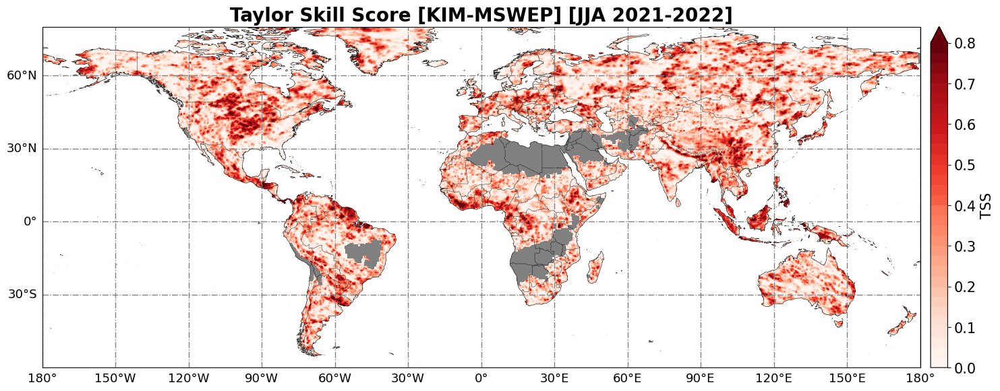

In [95]:
#def TSS_fig(data,data_source):
data = TSS
nan_mask = np.isnan(smoothed_data)  

tick_spacing = 30
projection = ccrs.PlateCarree()
crs = ccrs.PlateCarree()
fig = plt.figure(figsize=(20,10))
ax = plt.axes(projection=projection, frameon=True)


varMin, varMax, varInt = 0, 0.8, 0.025
levels = np.arange(varMin, varMax+varInt, varInt)
nlevs  = levels.size
tick_interval = 0.1
cmap = plt.get_cmap('Reds', nlevs)
extent=[-180, 180, -60, 80]

gl = ax.gridlines(crs=crs, draw_labels=True, linewidth=1, color='gray', alpha=1, linestyle='-.')
gl.xlabel_style = {"size" : 13}
gl.ylabel_style = {"size" : 13}
gl.xlocator = mticker.FixedLocator(np.arange(extent[0], extent[1] + tick_spacing, tick_spacing))
gl.ylocator = mticker.FixedLocator(np.arange(extent[2], extent[3] + tick_spacing, tick_spacing))

ax.xaxis.set_major_formatter(LongitudeFormatter())
ax.yaxis.set_major_formatter(LatitudeFormatter()) 

gl.top_labels = None
gl.right_labels = None

ax.add_feature(cfeature.COASTLINE.with_scale("50m"), lw=0.8)
#ax.add_feature(cfeature.OCEAN.with_scale("50m"), edgecolor='none', facecolor='lightgray')
ax.add_feature(cfeature.BORDERS.with_scale("50m"), lw=0.3)
ax.set_extent([-180, 180, -60, 80], crs=ccrs.PlateCarree())

lons = data['longitude']  # 경도
lats = data['latitude']  # 위도
values = smoothed_data

lons, lats = np.meshgrid(data['longitude'], data['latitude'])

cnplot = ax.contourf(lons, lats, values,cmap=cmap,levels=levels,zorder=0,
                     transform=ccrs.PlateCarree(),extend='max')
#extend = 'max'
cbar = plt.colorbar(cnplot,ticks=np.arange(varMin, varMax+tick_interval, tick_interval), 
                    orientation='vertical', pad=0.01, shrink=.658) 

ax.contourf(
    lons, lats, (nan_mask==True),
    transform=ccrs.PlateCarree(),
    colors='gray',
    levels=[0.5, 1.5],
)

cbar.set_label('TSS', fontsize=15)
cbar.ax.tick_params(labelsize=15)

plt.xlabel('Longitude',fontsize=10,fontweight='bold')
plt.ylabel('Latitude',fontsize=10,fontweight='bold')    
ax.set_title('Taylor Skill Score [KIM-MSWEP]'+' [JJA 2021-2022]',fontsize=20,fontweight='bold')
ax.add_feature(cfeature.NaturalEarthFeature('physical','ocean','50m', edgecolor='None', facecolor='white'))

plt.show()


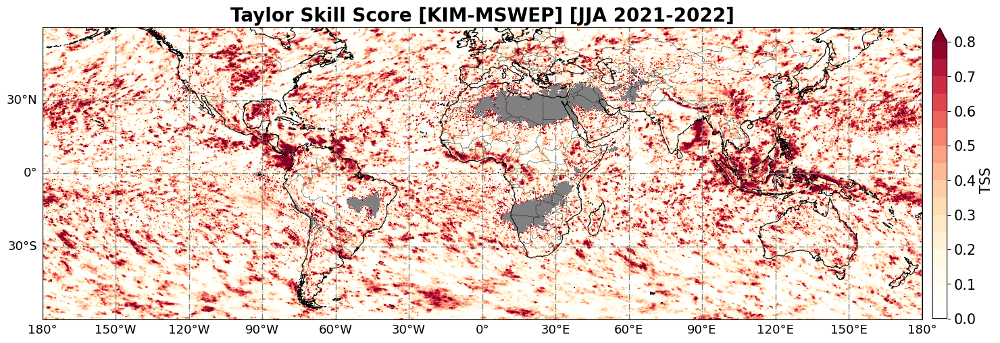

In [11]:
with ProgressBar():
    
    TSS_fig(TSS,'Taylor Skill Score [KIM-MSWEP]')

### Amplitude differ (KIM-MSWEP)

In [79]:
def amp_diff_fig(data):

    nan_mask = np.isnan(amp_differ)  
    
    tick_spacing = 30
    projection = ccrs.PlateCarree()
    crs = ccrs.PlateCarree()
    fig = plt.figure(figsize=(20,10))
    ax = plt.axes(projection=projection, frameon=True)


    varMin, varMax, varInt = -1, 1, 0.05
    levels = np.arange(varMin, varMax+varInt, varInt)
    nlevs  = levels.size
    tick_interval = 0.2
    cmap = plt.get_cmap('bwr_r', nlevs)
    extent=[-180, 180, -60, 80]

    gl = ax.gridlines(crs=crs, draw_labels=True, linewidth=1, color='gray', alpha=1, linestyle='-.')
    gl.xlabel_style = {"size" : 13}
    gl.ylabel_style = {"size" : 13}
    gl.xlocator = mticker.FixedLocator(np.arange(extent[0], extent[1] + tick_spacing, tick_spacing))
    gl.ylocator = mticker.FixedLocator(np.arange(extent[2], extent[3] + tick_spacing, tick_spacing))

    ax.xaxis.set_major_formatter(LongitudeFormatter())
    ax.yaxis.set_major_formatter(LatitudeFormatter()) 

    gl.top_labels = None
    gl.right_labels = None

    ax.add_feature(cfeature.COASTLINE.with_scale("50m"), lw=0.8)
    ax.add_feature(cfeature.OCEAN.with_scale("50m"), edgecolor='none', facecolor='lightgray')
    ax.add_feature(cfeature.BORDERS.with_scale("50m"), lw=0.3)
    ax.set_extent([-180, 180, -60, 80], crs=ccrs.PlateCarree())

    lons = data['longitude']  # 경도
    lats = data['latitude']  # 위도
    values = data

    lons, lats = np.meshgrid(data['longitude'], data['latitude'])

    cnplot = ax.contourf(lons, lats, values,cmap=cmap,levels=levels,zorder=0,
                         transform=ccrs.PlateCarree(),extend='both')

    cbar = plt.colorbar(cnplot,ticks=np.arange(varMin, varMax+tick_interval, tick_interval), 
                        orientation='vertical', pad=0.01, shrink=.658) 

    ax.contourf(
        lons, lats, (nan_mask==True),
        transform=ccrs.PlateCarree(),
        colors='gray',
        levels=[0.5, 1.5],
    )
    
    
    cbar.set_label('[mm/3h]', fontsize=15)
    cbar.ax.tick_params(labelsize=15)

    plt.xlabel('Longitude',fontsize=10,fontweight='bold')
    plt.ylabel('Latitude',fontsize=10,fontweight='bold')    
    ax.set_title('Amplitude KIM-MSWEP'+' [JJA 2021-2022]',fontsize=20,fontweight='bold')
    plt.savefig('/home/gychoi/Python/Lab/output_file/professor_file/Amplitude_differ.png',format='png', dpi=200,bbox_inches='tight')

    plt.show()


In [8]:
kim= xr.open_dataset('/home/gychoi/Python/Lab/output_file/professor_file/kim_diurnal_data.nc')

In [9]:
mswep= xr.open_dataset('/home/gychoi/Python/Lab/output_file/professor_file/mswep_diurnal_data.nc')

In [11]:
amp_differ = kim['amplitude']-mswep['amplitude']

In [12]:
amp_differ

<xarray.DataArray 'amplitude' (latitude: 1440, longitude: 2880)>
array([[ 0.00032531,  0.00035677,  0.00033001, ...,  0.00117536,
         0.00113399,  0.00611594],
       [ 0.00217076,  0.00185583,  0.00148258, ...,  0.00449   ,
         0.00463583,  0.00819793],
       [ 0.00232363,  0.00200685,  0.00221326, ...,  0.00474488,
         0.00438005,  0.00777192],
       ...,
       [-0.00273472, -0.0023877 , -0.00252499, ..., -0.00163847,
        -0.00138854,  0.00611077],
       [-0.00257228, -0.00246637, -0.00293728, ..., -0.0014753 ,
        -0.00138605,  0.00583418],
       [-0.00169516, -0.00159272, -0.00127249, ..., -0.00296489,
        -0.00304059,  0.00602705]])
Coordinates:
  * latitude   (latitude) float64 -89.94 -89.81 -89.69 ... 89.69 89.81 89.94
  * longitude  (longitude) float64 -179.9 -179.8 -179.6 ... 179.8 179.9 180.0

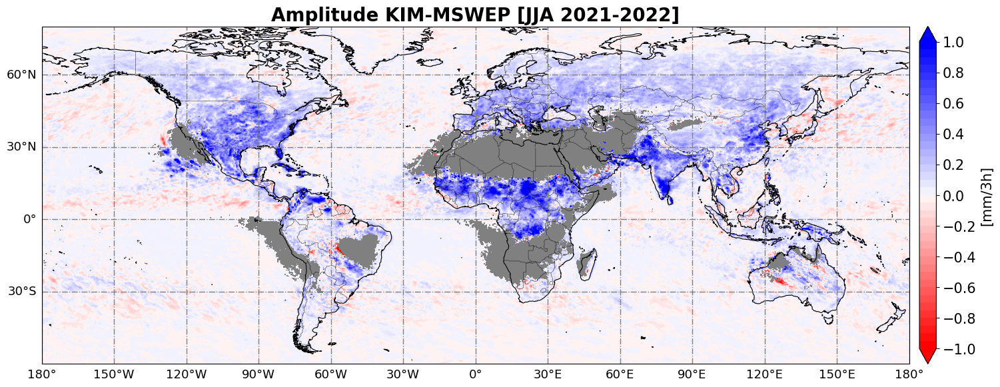

In [80]:
amp_diff_fig(amp_differ)

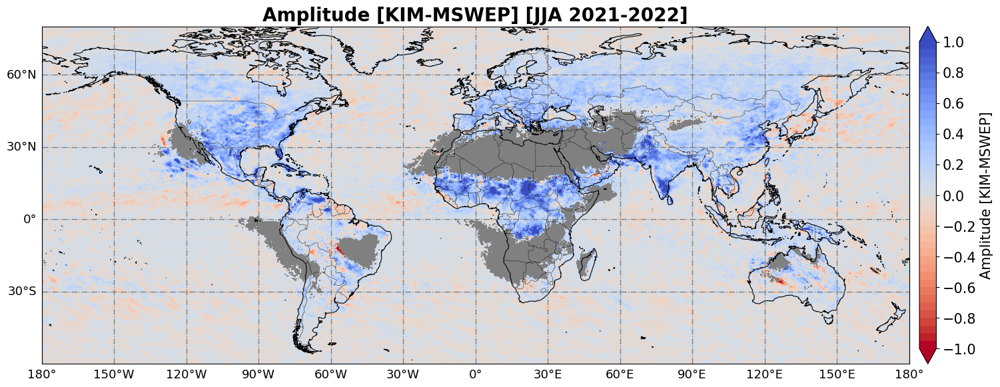

In [102]:
amp_diff_fig(amp_differ)

### Accuracy

#### mswep

In [21]:
mswep_acc=xr.open_dataset('/home/gychoi/Python/Lab/output_file/mswep_pre_prob.nc')
mswep_acc = grid_transfer(mswep_acc)

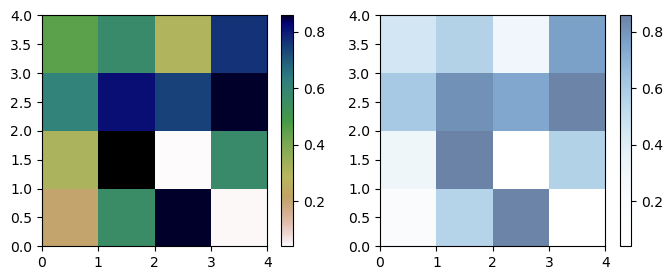

In [105]:
import numpy as np
import matplotlib.pylab as pl
from matplotlib.colors import ListedColormap

# Random data
data1 = np.random.random((4,4))

# Choose colormap which will be mixed with the alpha values
cmap = pl.cm.Blues

# Get the colormap colors
my_cmap = cmap(np.arange(cmap.N))
# Define the alphas in the range from 0 to 1
alphas = np.linspace(0, 0.6, cmap.N)
# Define the background as white
BG = np.asarray([1., 1., 1.,])
# Mix the colors with the background
for i in range(cmap.N):
    my_cmap[i,:-1] = my_cmap[i,:-1] * alphas[i] + BG * (1.-alphas[i])
# Create new colormap which mimics the alpha values
my_cmap = ListedColormap(my_cmap)

# Plot
f, axs = pl.subplots(1,2, figsize=(8,3))
h = axs[0].pcolormesh(data1, cmap=pl.cm.gist_earth_r)
cb = f.colorbar(h, ax=axs[0])

h = axs[1].pcolormesh(data1, cmap=my_cmap)
cb = pl.colorbar(h, ax=axs[1])
f.show()

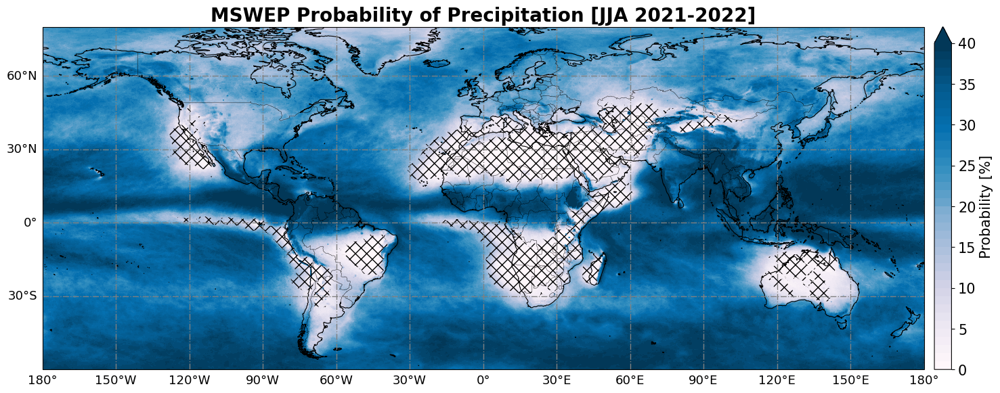

In [106]:
#def TSS_fig(data,data_source):
data = mswep_acc['precipitation']*100
#nan_mask = np.isnan(smoothed_data)  

tick_spacing = 30
projection = ccrs.PlateCarree()
crs = ccrs.PlateCarree()
fig = plt.figure(figsize=(20,10))
ax = plt.axes(projection=projection, frameon=True)


varMin, varMax, varInt = 0, 40, 1
levels = np.arange(varMin, varMax+varInt, varInt)
nlevs  = levels.size
tick_interval = 5
cmap =plt.get_cmap('PuBu', nlevs)
extent=[-180, 180, -60, 80]

gl = ax.gridlines(crs=crs, draw_labels=True, linewidth=1, color='gray', alpha=1, linestyle='-.')
gl.xlabel_style = {"size" : 13}
gl.ylabel_style = {"size" : 13}
gl.xlocator = mticker.FixedLocator(np.arange(extent[0], extent[1] + tick_spacing, tick_spacing))
gl.ylocator = mticker.FixedLocator(np.arange(extent[2], extent[3] + tick_spacing, tick_spacing))

ax.xaxis.set_major_formatter(LongitudeFormatter())
ax.yaxis.set_major_formatter(LatitudeFormatter()) 

gl.top_labels = None
gl.right_labels = None

ax.add_feature(cfeature.COASTLINE.with_scale("50m"), lw=0.8)
ax.add_feature(cfeature.OCEAN.with_scale("50m"), edgecolor='none', facecolor='lightgray')
ax.add_feature(cfeature.BORDERS.with_scale("50m"), lw=0.3)
ax.set_extent([-180, 180, -60, 80], crs=ccrs.PlateCarree())

lons = data['longitude']  # 경도
lats = data['latitude']  # 위도
values = data

lons, lats = np.meshgrid(data['longitude'], data['latitude'])

cnplot = ax.contourf(lons, lats, values,cmap=cmap,levels=levels,zorder=0,
                     transform=ccrs.PlateCarree(),extend='max')
#extend = 'max'
cbar = plt.colorbar(cnplot,ticks=np.arange(varMin, varMax+tick_interval, tick_interval), 
                    orientation='vertical', pad=0.01, shrink=.658) 

ax.contourf(
    lons, lats, (mswep_mean<0.275),
    transform=ccrs.PlateCarree(),
    colors='none',
    levels=[0.5, 1.5],
    hatches=['xx'],
) ## 이거 써야지 제대로 됨

cbar.set_label('Probability [%]', fontsize=15)
cbar.ax.tick_params(labelsize=15)

plt.xlabel('Longitude',fontsize=10,fontweight='bold')
plt.ylabel('Latitude',fontsize=10,fontweight='bold')    
ax.set_title('MSWEP Probability of Precipitation'+' [JJA 2021-2022]',fontsize=20,fontweight='bold')
#ax.add_feature(cfeature.NaturalEarthFeature('physical','ocean','50m', edgecolor='None', facecolor='lightgray'))

plt.show()


#### kim

In [23]:
kim_acc=xr.open_dataset('/home/gychoi/Python/Lab/output_file/kim_pre_prob.nc')
#mswep_acc = grid_transfer(mswep_acc)

In [24]:
kim_acc

<xarray.Dataset>
Dimensions:          (latitude: 1440, longitude: 2880)
Coordinates:
  * longitude        (longitude) float64 -179.9 -179.8 -179.6 ... 179.9 180.0
  * latitude         (latitude) float64 -89.94 -89.81 -89.69 ... 89.81 89.94
Data variables:
    pre_probability  (latitude, longitude) float64 ...

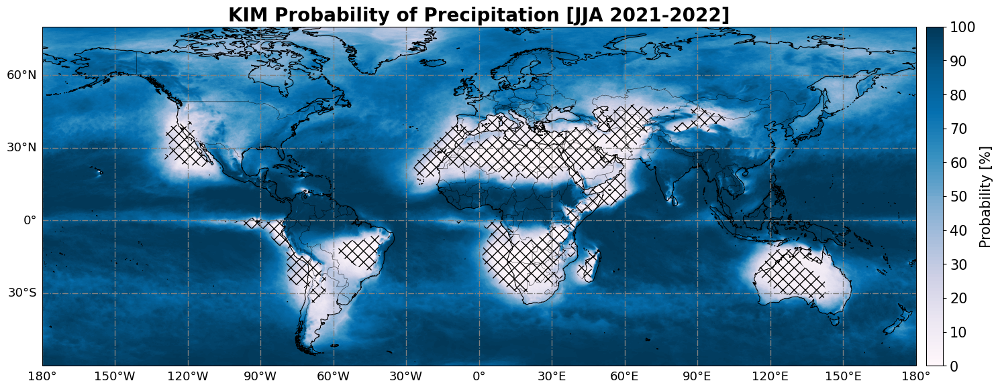

In [109]:
#def TSS_fig(data,data_source):
data = kim_acc['pre_probability']*100
#nan_mask = np.isnan(smoothed_data)  

tick_spacing = 30
projection = ccrs.PlateCarree()
crs = ccrs.PlateCarree()
fig = plt.figure(figsize=(20,10))
ax = plt.axes(projection=projection, frameon=True)


varMin, varMax, varInt = 0, 100, 1
levels = np.arange(varMin, varMax+varInt, varInt)
nlevs  = levels.size
tick_interval = 10
cmap =plt.get_cmap('PuBu', nlevs)
extent=[-180, 180, -60, 80]

gl = ax.gridlines(crs=crs, draw_labels=True, linewidth=1, color='gray', alpha=1, linestyle='-.')
gl.xlabel_style = {"size" : 13}
gl.ylabel_style = {"size" : 13}
gl.xlocator = mticker.FixedLocator(np.arange(extent[0], extent[1] + tick_spacing, tick_spacing))
gl.ylocator = mticker.FixedLocator(np.arange(extent[2], extent[3] + tick_spacing, tick_spacing))

ax.xaxis.set_major_formatter(LongitudeFormatter())
ax.yaxis.set_major_formatter(LatitudeFormatter()) 

gl.top_labels = None
gl.right_labels = None

ax.add_feature(cfeature.COASTLINE.with_scale("50m"), lw=0.8)
ax.add_feature(cfeature.OCEAN.with_scale("50m"), edgecolor='none', facecolor='lightgray')
ax.add_feature(cfeature.BORDERS.with_scale("50m"), lw=0.3)
ax.set_extent([-180, 180, -60, 80], crs=ccrs.PlateCarree())

lons = data['longitude']  # 경도
lats = data['latitude']  # 위도
values = data

lons, lats = np.meshgrid(data['longitude'], data['latitude'])

cnplot = ax.contourf(lons, lats, values,cmap=cmap,levels=levels,zorder=0,
                     transform=ccrs.PlateCarree())
#extend = 'max'
cbar = plt.colorbar(cnplot,ticks=np.arange(varMin, varMax+tick_interval, tick_interval), 
                    orientation='vertical', pad=0.01, shrink=.658) 

ax.contourf(
    lons, lats, (kim_mean<0.275),
    transform=ccrs.PlateCarree(),
    colors='none',
    levels=[0.5, 1.5],
    hatches=['xx'],
) ## 이거 써야지 제대로 됨

cbar.set_label('Probability [%]', fontsize=15)
cbar.ax.tick_params(labelsize=15)

plt.xlabel('Longitude',fontsize=10,fontweight='bold')
plt.ylabel('Latitude',fontsize=10,fontweight='bold')    
ax.set_title('KIM Probability of Precipitation'+' [JJA 2021-2022]',fontsize=20,fontweight='bold')
#ax.add_feature(cfeature.NaturalEarthFeature('physical','ocean','50m', edgecolor='None', facecolor='lightgray'))

plt.show()


#### differ

In [110]:
acc_differ=kim_acc['pre_probability']-mswep_acc['precipitation']

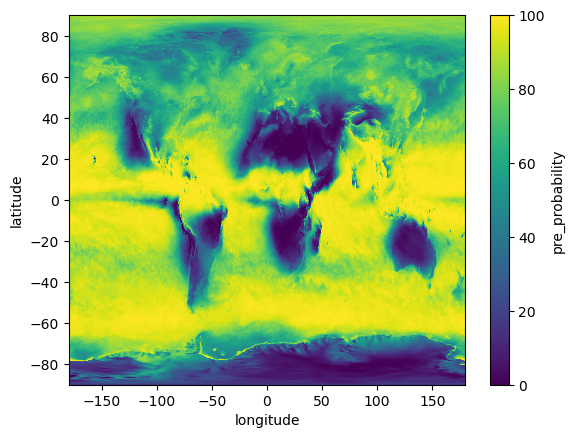

In [67]:
(kim_acc['pre_probability']*100).plot()

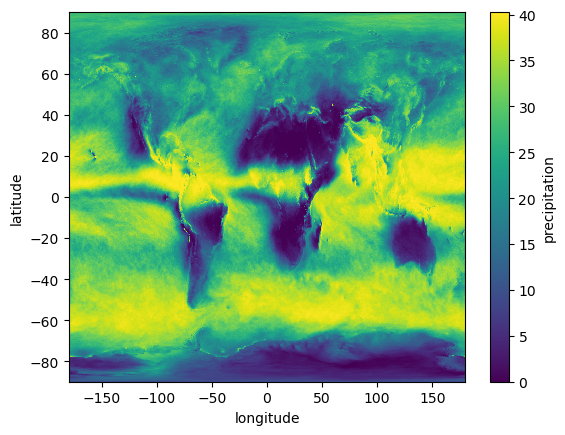

In [68]:
(mswep_acc['precipitation']*100).plot()

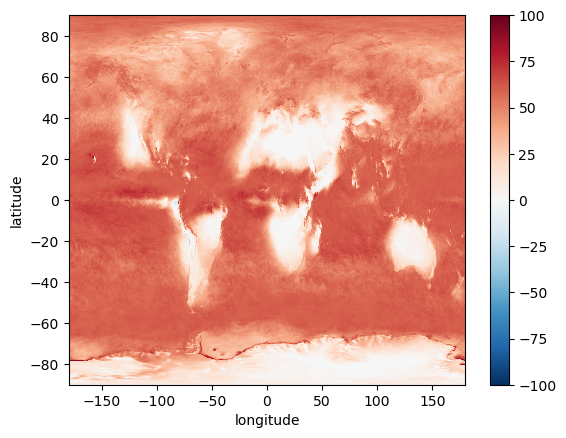

In [69]:
(acc_differ*100).plot()

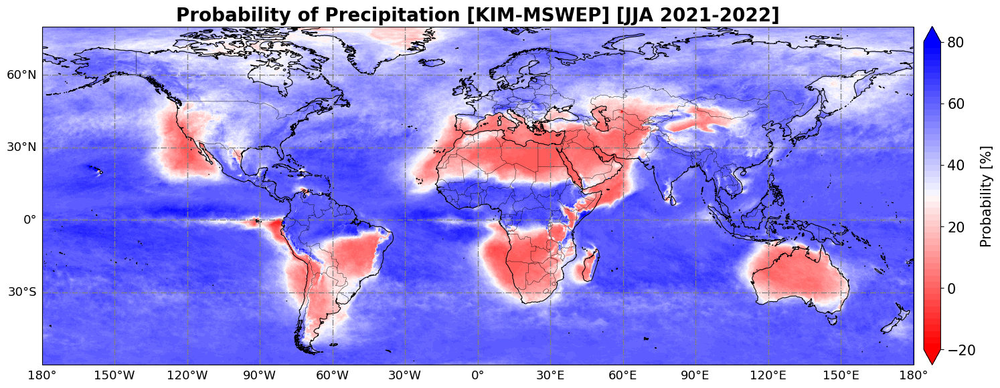

In [111]:
data = acc_differ*100

#nan_mask = np.isnan(amp_differ)  

tick_spacing = 30
projection = ccrs.PlateCarree()
crs = ccrs.PlateCarree()
fig = plt.figure(figsize=(20,10))
ax = plt.axes(projection=projection, frameon=True)


varMin, varMax, varInt = -20, 80, 2
levels = np.arange(varMin, varMax+varInt, varInt)
nlevs  = levels.size
tick_interval = 20
cmap = plt.get_cmap('bwr_r', nlevs)
extent=[-180, 180, -60, 80]

gl = ax.gridlines(crs=crs, draw_labels=True, linewidth=1, color='gray', alpha=1, linestyle='-.')
gl.xlabel_style = {"size" : 13}
gl.ylabel_style = {"size" : 13}
gl.xlocator = mticker.FixedLocator(np.arange(extent[0], extent[1] + tick_spacing, tick_spacing))
gl.ylocator = mticker.FixedLocator(np.arange(extent[2], extent[3] + tick_spacing, tick_spacing))

ax.xaxis.set_major_formatter(LongitudeFormatter())
ax.yaxis.set_major_formatter(LatitudeFormatter()) 

gl.top_labels = None
gl.right_labels = None

ax.add_feature(cfeature.COASTLINE.with_scale("50m"), lw=0.8)
ax.add_feature(cfeature.OCEAN.with_scale("50m"), edgecolor='none', facecolor='lightgray')
ax.add_feature(cfeature.BORDERS.with_scale("50m"), lw=0.3)
ax.set_extent([-180, 180, -60, 80], crs=ccrs.PlateCarree())

lons = data['longitude']  # 경도
lats = data['latitude']  # 위도
values = data

lons, lats = np.meshgrid(data['longitude'], data['latitude'])

cnplot = ax.contourf(lons, lats, values,cmap=cmap,levels=levels,zorder=0,
                     transform=ccrs.PlateCarree(),extend='both')

cbar = plt.colorbar(cnplot,ticks=np.arange(varMin, varMax+tick_interval, tick_interval), 
                    orientation='vertical', pad=0.01, shrink=.658) 

# ax.contourf(
#     lons, lats, (nan_mask==True),
#     transform=ccrs.PlateCarree(),
#     colors='gray',
#     levels=[0.5, 1.5],
# )


cbar.set_label('Probability [%]', fontsize=15)
cbar.ax.tick_params(labelsize=15)

plt.xlabel('Longitude',fontsize=10,fontweight='bold')
plt.ylabel('Latitude',fontsize=10,fontweight='bold')    
ax.set_title('Probability of Precipitation [KIM-MSWEP]'+' [JJA 2021-2022]',fontsize=20,fontweight='bold')
plt.show()


### 몇번인지? ,0.275 이상인 날의 평균 강수량

In [70]:
def pre_mean(data,nan,title,color_scale,max_value,label_tick):
    
    nan_mask = np.isnan(nan)  

    
    tick_spacing = 30
    projection = ccrs.PlateCarree()
    crs = ccrs.PlateCarree()
    fig = plt.figure(figsize=(20,10))
    ax = plt.axes(projection=projection, frameon=True)


    varMin, varMax, varInt = 0, max_value, max_value/100
    levels = np.arange(varMin, varMax+varInt, varInt)
    nlevs  = levels.size
    tick_interval = label_tick
    cmap =plt.get_cmap('PuBu', nlevs)
    extent=[-180, 180, -60, 80]

    gl = ax.gridlines(crs=crs, draw_labels=True, linewidth=1, color='gray', alpha=1, linestyle='-.')
    gl.xlabel_style = {"size" : 13}
    gl.ylabel_style = {"size" : 13}
    gl.xlocator = mticker.FixedLocator(np.arange(extent[0], extent[1] + tick_spacing, tick_spacing))
    gl.ylocator = mticker.FixedLocator(np.arange(extent[2], extent[3] + tick_spacing, tick_spacing))

    ax.xaxis.set_major_formatter(LongitudeFormatter())
    ax.yaxis.set_major_formatter(LatitudeFormatter()) 

    gl.top_labels = None
    gl.right_labels = None

    ax.add_feature(cfeature.COASTLINE.with_scale("50m"), lw=0.8)
    ax.add_feature(cfeature.OCEAN.with_scale("50m"), edgecolor='none', facecolor='lightgray')
    ax.add_feature(cfeature.BORDERS.with_scale("50m"), lw=0.3)
    ax.set_extent([-180, 180, -60, 80], crs=ccrs.PlateCarree())

    lons = data['longitude']  # 경도
    lats = data['latitude']  # 위도
    values = data

    lons, lats = np.meshgrid(data['longitude'], data['latitude'])

    cnplot = ax.contourf(lons, lats, values,cmap=cmap,levels=levels,zorder=0,
                         transform=ccrs.PlateCarree())
    #extend = 'max'
    cbar = plt.colorbar(cnplot,ticks=np.arange(varMin, varMax+tick_interval, tick_interval), 
                        orientation='vertical', pad=0.01, shrink=.658) 

    # ax.contourf(
    #     lons, lats, (mswep_mean<0.275),
    #     transform=ccrs.PlateCarree(),
    #     colors='none',
    #     levels=[0.5, 1.5],
    #     hatches=['xx'],
    # ) ## 이거 써야지 제대로 됨
    
    ax.contourf(
    lons, lats, nan_mask,
    transform=ccrs.PlateCarree(),
    colors='gray',
    levels=[0.5, 1],
                        )

    cbar.set_label(color_scale, fontsize=15)
    cbar.ax.tick_params(labelsize=15)

    plt.xlabel('Longitude',fontsize=10,fontweight='bold')
    plt.ylabel('Latitude',fontsize=10,fontweight='bold')    
    ax.set_title(title+' [JJA 2021-2022]',fontsize=20,fontweight='bold')
    #ax.add_feature(cfeature.NaturalEarthFeature('physical','ocean','50m', edgecolor='None', facecolor='lightgray'))
    plt.savefig('/home/gychoi/Python/Lab/output_file/professor_file/mswep_freq.png',format='png', dpi=200,bbox_inches='tight')

    plt.show()


In [13]:
mswep_yes=xr.open_dataset('/home/gychoi/Python/Lab/output_file/professor_file/mswep_yes_mean.nc')
mswep_freq = xr.open_dataset('/home/gychoi/Python/Lab/output_file/professor_file/mswep_pre_freq.nc')

In [14]:
mswep_yes = grid_transfer(mswep_yes)
mswep_freq = grid_transfer(mswep_freq)

In [15]:
kim_yes = xr.open_dataset('/home/gychoi/Python/Lab/output_file/professor_file/kim_yes_mean.nc')
kim_yes = grid_transfer(kim_yes)

In [16]:
kim_freq = xr.open_dataset('/home/gychoi/Python/Lab/output_file/professor_file/kim_pre_freq.nc')
kim_freq = grid_transfer(kim_freq)

In [75]:
kim_freq['tpr']=kim_freq['tpr']/184

In [59]:
mswep_freq['precipitation']=mswep_freq['precipitation']/184

In [60]:
mswep_freq['precipitation'].values.max()

1.0

In [61]:
kim_freq['tpr'].values.max()

1.0108695652173914

In [51]:
max(mswep_freq['precipitation'].values)

ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()

In [121]:
mswep_yes=grid_transfer(mswep_yes)
mswep_freq=grid_transfer(mswep_freq)
kim_yes=grid_transfer(kim_yes)
kim_freq=grid_transfer(kim_freq)

#### MSWEP

##### 평균

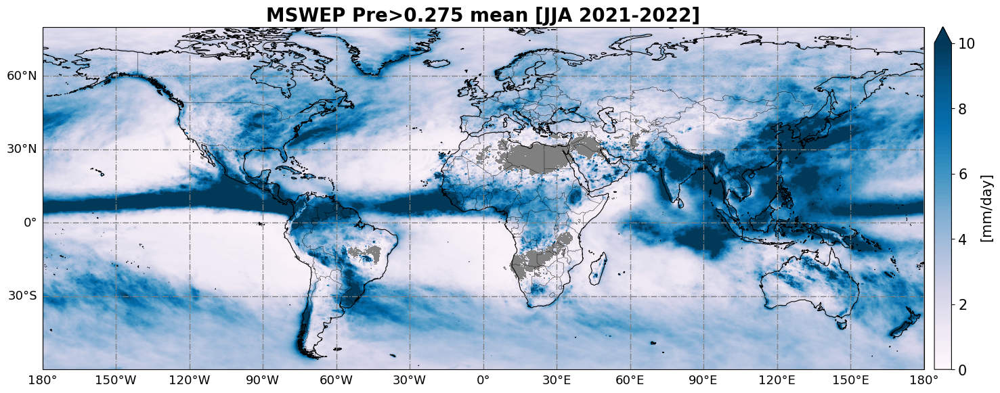

In [44]:
pre_mean(mswep_yes['precipitation'],mswep_yes['precipitation'],'MSWEP Pre>0.275 mean','[mm/day]',10,2)

##### 몇번

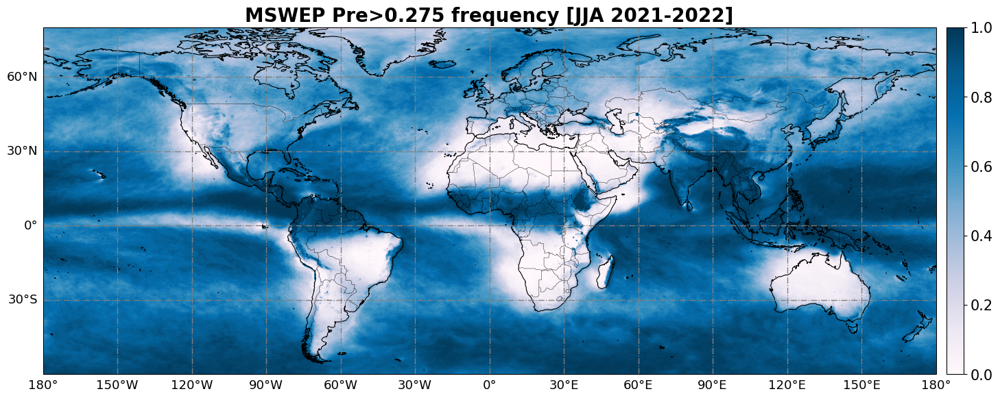

In [71]:
pre_mean(mswep_freq['precipitation'],mswep_freq['precipitation'],'MSWEP Pre>0.275 frequency',None,1,0.2,)

#### KIM

##### 평균

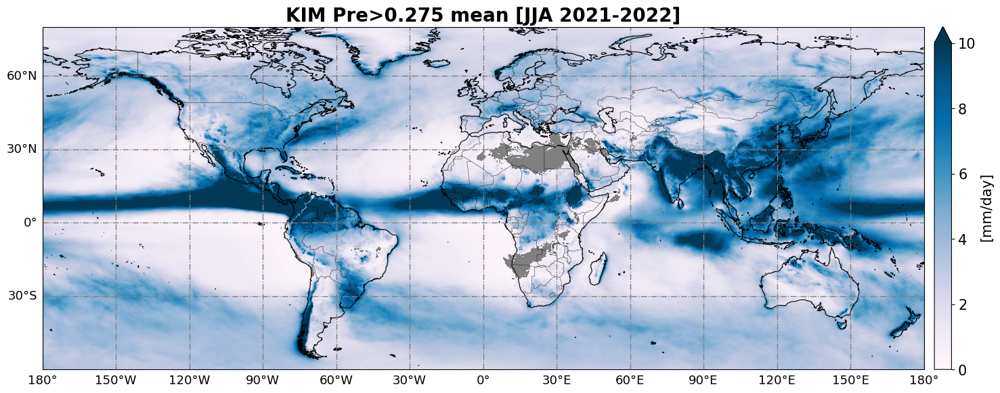

In [46]:
with ProgressBar():
    pre_mean(kim_yes['tpr'],kim_yes['tpr'],'KIM Pre>0.275 mean','[mm/day]',10,2)

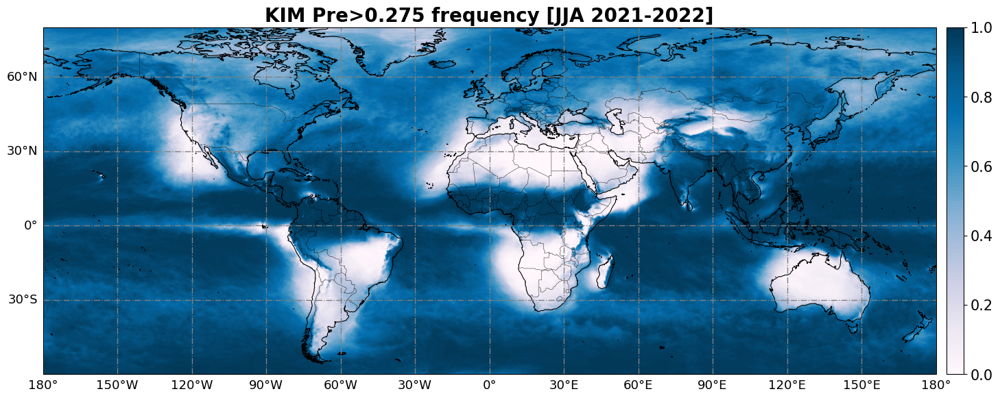

In [69]:
with ProgressBar():
    pre_mean(kim_freq['tpr'],kim_freq['tpr'],'KIM Pre>0.275 frequency',None,1,0.2)

In [76]:
freq_diff=kim_freq['tpr']-mswep_freq['precipitation']

In [35]:
yes_mean_differ1=kim_yes['tpr']-mswep_yes['precipitation']

In [36]:
yes_mean_differnan = np.where(np.isnan(kim_yes['tpr']) | np.isnan(mswep_yes['precipitation']),
                              np.nan, kim_yes['tpr'] - mswep_yes['precipitation'])

In [21]:
yes_mean_differ2=(kim_yes['tpr']-mswep_yes['precipitation'])/mswep_yes['precipitation']

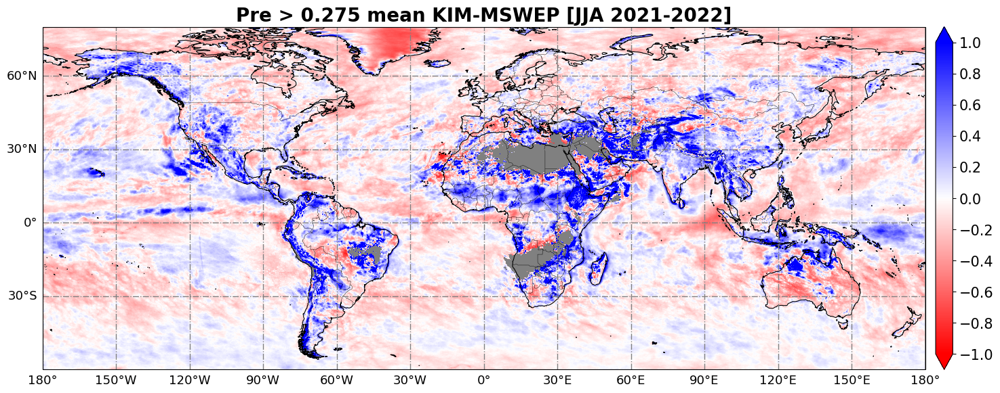

In [38]:
data = yes_mean_differ2
nan_mask = np.isnan(yes_mean_differnan)
tick_spacing = 30
projection = ccrs.PlateCarree()
crs = ccrs.PlateCarree()
fig = plt.figure(figsize=(20,10))
ax = plt.axes(projection=projection, frameon=True)


varMin, varMax, varInt = -1, 1, 1/100
levels = np.arange(varMin, varMax+varInt, varInt)
nlevs  = levels.size
tick_interval = 0.2
cmap =plt.get_cmap('bwr_r', nlevs)
extent=[-180, 180, -60, 80]

gl = ax.gridlines(crs=crs, draw_labels=True, linewidth=1, color='gray', alpha=1, linestyle='-.')
gl.xlabel_style = {"size" : 13}
gl.ylabel_style = {"size" : 13}
gl.xlocator = mticker.FixedLocator(np.arange(extent[0], extent[1] + tick_spacing, tick_spacing))
gl.ylocator = mticker.FixedLocator(np.arange(extent[2], extent[3] + tick_spacing, tick_spacing))

ax.xaxis.set_major_formatter(LongitudeFormatter())
ax.yaxis.set_major_formatter(LatitudeFormatter()) 

gl.top_labels = None
gl.right_labels = None

ax.add_feature(cfeature.COASTLINE.with_scale("50m"), lw=0.8)
ax.add_feature(cfeature.OCEAN.with_scale("50m"), edgecolor='none', facecolor='lightgray')
ax.add_feature(cfeature.BORDERS.with_scale("50m"), lw=0.3)
ax.set_extent([-180, 180, -60, 80], crs=ccrs.PlateCarree())

lons = data['longitude']  # 경도
lats = data['latitude']  # 위도
values = data

lons, lats = np.meshgrid(data['longitude'], data['latitude'])

cnplot = ax.contourf(lons, lats, values,cmap=cmap,levels=levels,zorder=0,
                     transform=ccrs.PlateCarree(),extend='both')
#extend = 'max'
cbar = plt.colorbar(cnplot,ticks=np.arange(varMin, varMax+tick_interval, tick_interval), 
                    orientation='vertical', pad=0.01, shrink=.658) 

# ax.contourf(
#     lons, lats, (mswep_mean<0.275),
#     transform=ccrs.PlateCarree(),
#     colors='none',
#     levels=[0.5, 1.5],
#     hatches=['xx'],
# ) ## 이거 써야지 제대로 됨

ax.contourf(
lons, lats, nan_mask,
transform=ccrs.PlateCarree(),
colors='gray',
levels=[0.5, 1.5],
                    )

cbar.set_label(None, fontsize=15)
cbar.ax.tick_params(labelsize=15)

plt.xlabel('Longitude',fontsize=10,fontweight='bold')
plt.ylabel('Latitude',fontsize=10,fontweight='bold')    
ax.set_title('Pre > 0.275 mean KIM-MSWEP' + ' [JJA 2021-2022]',fontsize=20,fontweight='bold')
#ax.add_feature(cfeature.NaturalEarthFeature('physical','ocean','50m', edgecolor='None', facecolor='lightgray'))
plt.savefig('/home/gychoi/Python/Lab/output_file/professor_file/prec_mean_differ1.png',format='png', dpi=200,bbox_inches='tight')

plt.show()


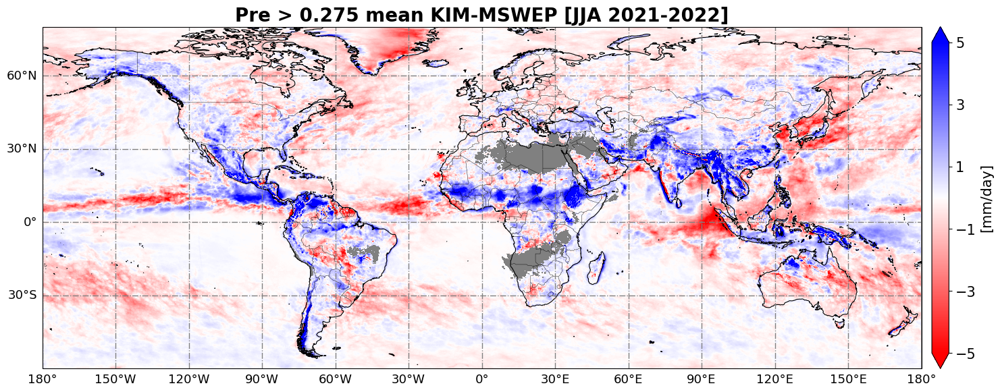

In [37]:
data = yes_mean_differ1
nan_mask = np.isnan(yes_mean_differnan)

tick_spacing = 30
projection = ccrs.PlateCarree()
crs = ccrs.PlateCarree()
fig = plt.figure(figsize=(20,10))
ax = plt.axes(projection=projection, frameon=True)


varMin, varMax, varInt = -5, 5, 5/100
levels = np.arange(varMin, varMax+varInt, varInt)
nlevs  = levels.size
tick_interval = 2
cmap =plt.get_cmap('bwr_r', nlevs)
extent=[-180, 180, -60, 80]

gl = ax.gridlines(crs=crs, draw_labels=True, linewidth=1, color='gray', alpha=1, linestyle='-.')
gl.xlabel_style = {"size" : 13}
gl.ylabel_style = {"size" : 13}
gl.xlocator = mticker.FixedLocator(np.arange(extent[0], extent[1] + tick_spacing, tick_spacing))
gl.ylocator = mticker.FixedLocator(np.arange(extent[2], extent[3] + tick_spacing, tick_spacing))

ax.xaxis.set_major_formatter(LongitudeFormatter())
ax.yaxis.set_major_formatter(LatitudeFormatter()) 

gl.top_labels = None
gl.right_labels = None

ax.add_feature(cfeature.COASTLINE.with_scale("50m"), lw=0.8)
ax.add_feature(cfeature.OCEAN.with_scale("50m"), edgecolor='none', facecolor='lightgray')
ax.add_feature(cfeature.BORDERS.with_scale("50m"), lw=0.3)
ax.set_extent([-180, 180, -60, 80], crs=ccrs.PlateCarree())

lons = data['longitude']  # 경도
lats = data['latitude']  # 위도
values = data

lons, lats = np.meshgrid(data['longitude'], data['latitude'])

cnplot = ax.contourf(lons, lats, values,cmap=cmap,levels=levels,zorder=0,
                     transform=ccrs.PlateCarree(),extend='both')
#extend = 'max'
cbar = plt.colorbar(cnplot,ticks=np.arange(varMin, varMax+tick_interval, tick_interval), 
                    orientation='vertical', pad=0.01, shrink=.658) 

# ax.contourf(
#     lons, lats, (mswep_mean<0.275),
#     transform=ccrs.PlateCarree(),
#     colors='none',
#     levels=[0.5, 1.5],
#     hatches=['xx'],
# ) ## 이거 써야지 제대로 됨

ax.contourf(
lons, lats, nan_mask,
transform=ccrs.PlateCarree(),
colors='gray',
levels=[0.5, 1.1],
                    )

cbar.set_label('[mm/day]', fontsize=15)
cbar.ax.tick_params(labelsize=15)

plt.xlabel('Longitude',fontsize=10,fontweight='bold')
plt.ylabel('Latitude',fontsize=10,fontweight='bold')    
ax.set_title('Pre > 0.275 mean KIM-MSWEP' + ' [JJA 2021-2022]',fontsize=20,fontweight='bold')
#ax.add_feature(cfeature.NaturalEarthFeature('physical','ocean','50m', edgecolor='None', facecolor='lightgray'))
plt.savefig('/home/gychoi/Python/Lab/output_file/professor_file/prec_mean_differ.png',format='png', dpi=200,bbox_inches='tight')

plt.show()


##### 몇번

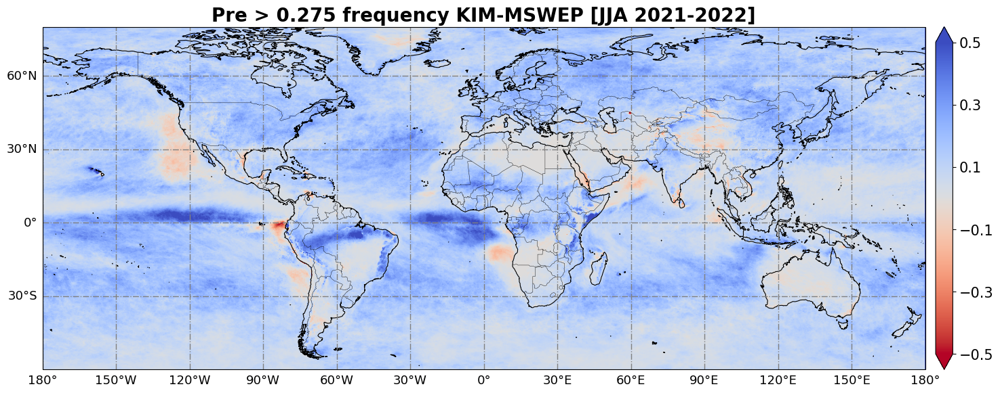

In [78]:
data = freq_diff

tick_spacing = 30
projection = ccrs.PlateCarree()
crs = ccrs.PlateCarree()
fig = plt.figure(figsize=(20,10))
ax = plt.axes(projection=projection, frameon=True)


varMin, varMax, varInt = -0.5, 0.5, 0.5/100
levels = np.arange(varMin, varMax+varInt, varInt)
nlevs  = levels.size
tick_interval = 0.2
cmap =plt.get_cmap('coolwarm_r', nlevs)
extent=[-180, 180, -60, 80]

gl = ax.gridlines(crs=crs, draw_labels=True, linewidth=1, color='gray', alpha=1, linestyle='-.')
gl.xlabel_style = {"size" : 13}
gl.ylabel_style = {"size" : 13}
gl.xlocator = mticker.FixedLocator(np.arange(extent[0], extent[1] + tick_spacing, tick_spacing))
gl.ylocator = mticker.FixedLocator(np.arange(extent[2], extent[3] + tick_spacing, tick_spacing))

ax.xaxis.set_major_formatter(LongitudeFormatter())
ax.yaxis.set_major_formatter(LatitudeFormatter()) 

gl.top_labels = None
gl.right_labels = None

ax.add_feature(cfeature.COASTLINE.with_scale("50m"), lw=0.8)
ax.add_feature(cfeature.OCEAN.with_scale("50m"), edgecolor='none', facecolor='lightgray')
ax.add_feature(cfeature.BORDERS.with_scale("50m"), lw=0.3)
ax.set_extent([-180, 180, -60, 80], crs=ccrs.PlateCarree())

lons = data['longitude']  # 경도
lats = data['latitude']  # 위도
values = data

lons, lats = np.meshgrid(data['longitude'], data['latitude'])

cnplot = ax.contourf(lons, lats, values,cmap=cmap,levels=levels,zorder=0,
                     transform=ccrs.PlateCarree(),extend='both')
#extend = 'max'
cbar = plt.colorbar(cnplot,ticks=np.arange(varMin, varMax+tick_interval, tick_interval), 
                    orientation='vertical', pad=0.01, shrink=.658) 

# ax.contourf(
#     lons, lats, (mswep_mean<0.275),
#     transform=ccrs.PlateCarree(),
#     colors='none',
#     levels=[0.5, 1.5],
#     hatches=['xx'],
# ) ## 이거 써야지 제대로 됨

# ax.contourf(
# lons, lats, nan_mask,
# transform=ccrs.PlateCarree(),
# colors='gray',
# levels=[0.5, 1],
#                     )

cbar.set_label(None, fontsize=15)
cbar.ax.tick_params(labelsize=15)

plt.xlabel('Longitude',fontsize=10,fontweight='bold')
plt.ylabel('Latitude',fontsize=10,fontweight='bold')    
ax.set_title('Pre > 0.275 frequency KIM-MSWEP'+' [JJA 2021-2022]',fontsize=20,fontweight='bold')
#ax.add_feature(cfeature.NaturalEarthFeature('physical','ocean','50m', edgecolor='None', facecolor='lightgray'))
plt.savefig('/home/gychoi/Python/Lab/output_file/professor_file/freq_differ.png',format='png', dpi=200,bbox_inches='tight')

plt.show()


## 자료 저장

In [518]:
with ProgressBar():
    kim.load().to_netcdf('/home/gychoi/Python/Lab/output_file/professor_file/kim_diurnal_data.nc')

In [519]:
with ProgressBar():
    
    kim_mean.load().to_netcdf('/home/gychoi/Python/Lab/output_file/professor_file/kim_diurnal_mean.nc')

In [520]:
with ProgressBar():
    mswep.load().to_netcdf('/home/gychoi/Python/Lab/output_file/professor_file/mswep_diurnal_data.nc')

In [521]:
with ProgressBar():
    mswep_mean.load().to_netcdf('/home/gychoi/Python/Lab/output_file/professor_file/mswep_diurnal_mean.nc')

In [524]:
with ProgressBar():
    TSS.load().to_netcdf('/home/gychoi/Python/Lab/output_file/professor_file/TSS.nc')

In [525]:
M=xr.open_dataarray('/home/gychoi/Python/Lab/output_file/professor_file/TSS.nc')